# Examen del módulo 1 del diplomado en Ciencia de Datos

In [1]:
import pandas as pd
import numpy as np
from scipy import stats
import re
import unicodedata
import nltk
import sys
import pathlib
import missingno as msno
from unidecode import unidecode
from random import sample
import chardet
import os
from pandas_profiling import ProfileReport
import gc

# Opciones
pd.set_option("display.max_columns",200)
pd.set_option("display.max_rows",100)
%matplotlib inline

In [2]:
df = pd.read_csv("data_examen.csv", sep=',', encoding='utf8')

### Obtener información básica acerca del CDD

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51000 entries, 0 to 50999
Data columns (total 32 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   ID_CLIENT                                  51000 non-null  int64  
 1   ID_SHOP                                    51000 non-null  int64  
 2   SEX                                        50997 non-null  object 
 3   MARITAL_STATUS                             51000 non-null  object 
 4   AGE                                        48528 non-null  float64
 5   QUANT_DEPENDANTS                           51000 non-null  int64  
 6   EDUCATION                                  0 non-null      float64
 7   FLAG_RESIDENCIAL_PHONE                     51000 non-null  object 
 8   AREA_CODE_RESIDENCIAL_PHONE                51000 non-null  int64  
 9   PAYMENT_DAY                                51000 non-null  int64  
 10  SHOP_RANK             

In [4]:
df.memory_usage()

Index                                           128
ID_CLIENT                                    408000
ID_SHOP                                      408000
SEX                                          408000
MARITAL_STATUS                               408000
AGE                                          408000
QUANT_DEPENDANTS                             408000
EDUCATION                                    408000
FLAG_RESIDENCIAL_PHONE                       408000
AREA_CODE_RESIDENCIAL_PHONE                  408000
PAYMENT_DAY                                  408000
SHOP_RANK                                    408000
RESIDENCE_TYPE                               408000
MONTHS_IN_RESIDENCE                          408000
FLAG_MOTHERS_NAME                            408000
FLAG_FATHERS_NAME                            408000
FLAG_RESIDENCE_TOWN=WORKING_TOWN             408000
FLAG_RESIDENCE_STATE=WORKING_STATE           408000
MONTHS_IN_THE_JOB                            408000
PROFESSION_C

In [5]:
df.shape

(51000, 32)

In [6]:
columnas = list(df.columns)

In [7]:
df.head(10)

,ID_CLIENT,ID_SHOP,SEX,MARITAL_STATUS,AGE,QUANT_DEPENDANTS,EDUCATION,FLAG_RESIDENCIAL_PHONE,AREA_CODE_RESIDENCIAL_PHONE,PAYMENT_DAY,SHOP_RANK,RESIDENCE_TYPE,MONTHS_IN_RESIDENCE,FLAG_MOTHERS_NAME,FLAG_FATHERS_NAME,FLAG_RESIDENCE_TOWN=WORKING_TOWN,FLAG_RESIDENCE_STATE=WORKING_STATE,MONTHS_IN_THE_JOB,PROFESSION_CODE,MATE_INCOME,FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,FLAG_OTHER_CARD,QUANT_BANKING_ACCOUNTS,PERSONAL_REFERENCE_#1,PERSONAL_REFERENCE_#2,FLAG_MOBILE_PHONE,FLAG_CONTACT_PHONE,PERSONAL_NET_INCOME,COD_APPLICATION_BOOTH,QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,FLAG_CARD_INSURANCE_OPTION,tgt
0,2,15,F,S,18.0,0,NaN,Y,31,20,0,P,216,Y,Y,Y,Y,12,853,0.0,Y,N,0,SARA,FELIPE,N,N,300.0,0,0,N,0
1,4,12,F,C,NaN,0,NaN,N,31,25,0,P,180,Y,Y,N,Y,24,35,0.0,Y,N,0,JACI,VALERIA ALEXANDRA TRAJANO,N,N,304.0,0,0,N,0
2,5,16,F,S,28.0,0,NaN,Y,31,25,0,,12,Y,Y,Y,Y,12,24,0.0,Y,N,0,NaN,SANDRO L P MARTINS,N,N,250.0,0,0,N,0
3,6,24,M,S,26.0,0,NaN,N,31,28,0,P,180,Y,Y,N,Y,0,999,0.0,Y,N,0,NaN,ANA,N,N,800.0,0,0,N,0
4,7,55,F,S,22.0,0,NaN,Y,31,12,0,A,0,Y,Y,Y,Y,48,999,0.0,Y,N,0,NaN,NaN,N,N,410.0,0,0,N,0
5,8,6,F,C,21.0,0,NaN,y,23,28,0,A,24,Y,Y,Y,Y,12,40,800.0,Y,N,0,OLIONA MARIA CAMPOS,ELIZETE CAMPS COELHO,N,NaN,248.0,0,0,N,0
6,9,3,F,S,27.0,0,NaN,Y,31,20,0,A,0,Y,Y,Y,Y,0,950,0.0,Y,N,0,SUELI,NaN,N,N,1000.0,0,0,N,1
7,10,23,F,C,57.0,0,NaN,Y,31,12,0,P,24,Y,Y,N,Y,96,13,0.0,Y,N,0,NaN,ZILDA,N,N,856.0,0,0,N,0
8,11,25,F,S,NaN,0,NaN,Y,31,18,0,P,60,Y,Y,N,Y,24,13,0.0,Y,N,0,NaN,MARIA MONICA,N,N,738.0,0,1,N,1
9,12,12,F,C,32.0,0,NaN,Y,31,12,0,P,24,Y,Y,N,Y,0,165,0.0,Y,N,0,NaN,ANA MARIA,N,N,700.0,0,0,N,0


In [8]:
data_dictionary = pd.read_excel("VariablesList.xlsx")

In [9]:
data_dictionary.head()

,Var_Id,Var_Title,Var_Description,Field_Content
0,1.0,ID_CLIENT,Sequential number for the applicant (to be use...,"1-50000, 50001-70000, 70001-90000"
1,2.0,CLERK_TYPE,Not informed,C
2,3.0,PAYMENT_DAY,"Day of the month for bill payment, chosen by t...","1,5,10,15,20,25"
3,4.0,APPLICATION_SUBMISSION_TYPE,Indicates if the application was submitted via...,"Web, Carga"
4,5.0,QUANT_ADDITIONAL_CARDS/QUANT_ADDITIONAL_CARDS_...,Quantity of additional cards asked for in the ...,"1,2,NULL"


In [10]:
cols2 = list(data_dictionary['Var_Title'])

In [11]:
set(columnas) - set(cols2)

{'AREA_CODE_RESIDENCIAL_PHONE',
 'COD_APPLICATION_BOOTH',
 'EDUCATION',
 'FLAG_CARD_INSURANCE_OPTION',
 'FLAG_FATHERS_NAME',
 'FLAG_MOTHERS_NAME',
 'FLAG_OTHER_CARD',
 'FLAG_RESIDENCE_STATE=WORKING_STATE',
 'FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS',
 'PERSONAL_NET_INCOME',
 'PERSONAL_REFERENCE_#1',
 'PERSONAL_REFERENCE_#2',
 'QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION',
 'SHOP_RANK',
 'tgt'}

In [12]:
# Obtener las coincidencias
c = list( (set(columnas) - set(cols2)) | set(columnas).intersection(set(cols2)))
c.sort()
c

['AGE',
 'AREA_CODE_RESIDENCIAL_PHONE',
 'COD_APPLICATION_BOOTH',
 'EDUCATION',
 'FLAG_CARD_INSURANCE_OPTION',
 'FLAG_CONTACT_PHONE',
 'FLAG_FATHERS_NAME',
 'FLAG_MOBILE_PHONE',
 'FLAG_MOTHERS_NAME',
 'FLAG_OTHER_CARD',
 'FLAG_RESIDENCE_STATE=WORKING_STATE',
 'FLAG_RESIDENCE_TOWN=WORKING_TOWN',
 'FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS',
 'FLAG_RESIDENCIAL_PHONE',
 'ID_CLIENT',
 'ID_SHOP',
 'MARITAL_STATUS',
 'MATE_INCOME',
 'MONTHS_IN_RESIDENCE',
 'MONTHS_IN_THE_JOB',
 'PAYMENT_DAY',
 'PERSONAL_NET_INCOME',
 'PERSONAL_REFERENCE_#1',
 'PERSONAL_REFERENCE_#2',
 'PROFESSION_CODE',
 'QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION',
 'QUANT_BANKING_ACCOUNTS',
 'QUANT_DEPENDANTS',
 'RESIDENCE_TYPE',
 'SEX',
 'SHOP_RANK',
 'tgt']

In [13]:
set(columnas).intersection(set(cols2))

{'AGE',
 'FLAG_CONTACT_PHONE',
 'FLAG_MOBILE_PHONE',
 'FLAG_RESIDENCE_TOWN=WORKING_TOWN',
 'FLAG_RESIDENCIAL_PHONE',
 'ID_CLIENT',
 'ID_SHOP',
 'MARITAL_STATUS',
 'MATE_INCOME',
 'MONTHS_IN_RESIDENCE',
 'MONTHS_IN_THE_JOB',
 'PAYMENT_DAY',
 'PROFESSION_CODE',
 'QUANT_BANKING_ACCOUNTS',
 'QUANT_DEPENDANTS',
 'RESIDENCE_TYPE',
 'SEX'}

In [14]:
len(set(columnas).intersection(set(cols2)))

17

In [15]:
len(columnas), len(c)

(32, 32)

In [16]:
set(cols2) - set(columnas)

{'APPLICATION_SUBMISSION_TYPE',
 'CITY_OF_BIRTH',
 'CLERK_TYPE',
 'COMPANY',
 'EDUCATION_LEVEL',
 'FLAG_ACSP_RECORD',
 'FLAG_AMERICAN_EXPRESS',
 'FLAG_CPF',
 'FLAG_DINERS',
 'FLAG_EMAIL',
 'FLAG_HOME_ADDRESS_DOCUMENT',
 'FLAG_INCOME_PROOF',
 'FLAG_MASTERCARD',
 'FLAG_OTHER_CARDS',
 'FLAG_PROFESSIONAL_PHONE',
 'FLAG_RG',
 'FLAG_VISA',
 'MATE_PROFESSION_CODE',
 'NACIONALITY',
 'OCCUPATION_TYPE',
 'OTHER_INCOMES',
 'PERSONAL_ASSETS_VALUE',
 'PERSONAL_MONTHLY_INCOME/PERSONAL_NET_INCOME',
 'POSTAL_ADDRESS_TYPE',
 'PRODUCT',
 'PROFESSIONAL_BOROUGH',
 'PROFESSIONAL_CITY',
 'PROFESSIONAL_PHONE_AREA_CODE',
 'PROFESSIONAL_STATE',
 'PROFESSIONAL_ZIP_3',
 'QUANT_ADDITIONAL_CARDS/QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION',
 'QUANT_CARS',
 'QUANT_SPECIAL_BANKING_ACCOUNTS',
 'RESIDENCIAL_BOROUGH',
 'RESIDENCIAL_CITY',
 'RESIDENCIAL_PHONE_AREA_CODE',
 'RESIDENCIAL_STATE',
 'RESIDENCIAL_ZIP_3',
 'STATE_OF_BIRTH',
 'TARGET_LABEL_BAD=1 (tgt)'}

Las variables que se describen en el diccionario de datos no coinciden en su mayoría con las variables que se encuentran en el DataSet, sin embargo, los nombres son los suficientemente explícitos como para poder trabajar con todas las variables

In [17]:
ocupaciones = pd.read_csv("ocupaciones_examen.csv", encoding='utf8', sep=',')

In [18]:
ocupaciones

,PROFESSION_CODE,PROFESSION
0,999,Healthcare Practitioners and Technical
1,950,Healthcare Practitioners and Technical
2,13,Educational Instruction and Library
3,205,Production
4,703,Educational Instruction and Library
...,...,...
290,152,Production
291,516,"Life, Physical, and Social Science"
292,50,Educational Instruction and Library
293,850,"Life, Physical, and Social Science"


In [19]:
# gc.collect()
del(data_dictionary)
del(c)
del(cols2)
del(columnas)

# Calidad de datos

### Etiquetado de variables

<AxesSubplot:>

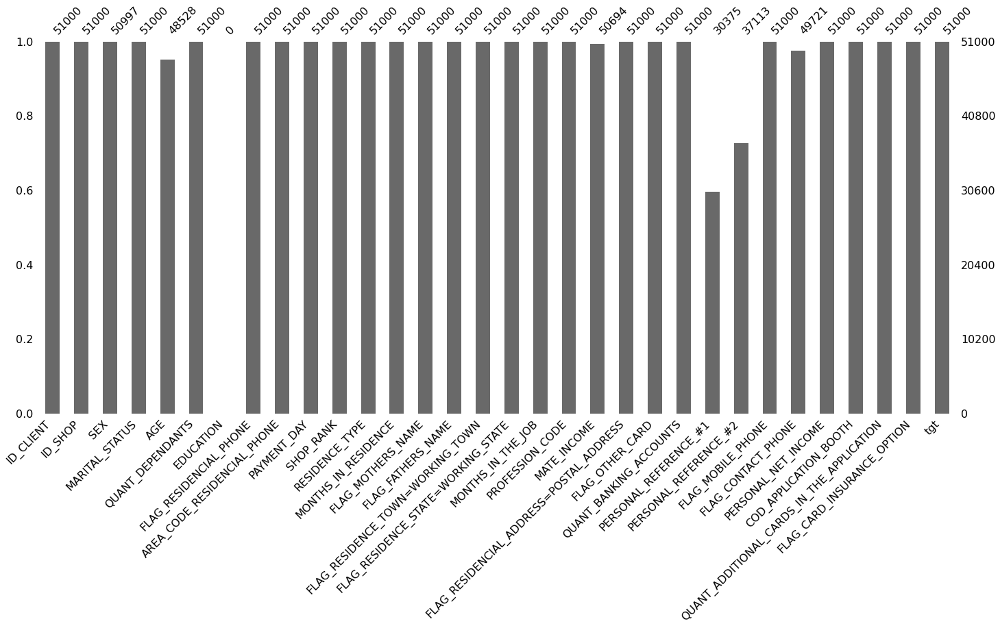

In [20]:
msno.bar(df)

In [21]:
df.head()

,ID_CLIENT,ID_SHOP,SEX,MARITAL_STATUS,AGE,QUANT_DEPENDANTS,EDUCATION,FLAG_RESIDENCIAL_PHONE,AREA_CODE_RESIDENCIAL_PHONE,PAYMENT_DAY,SHOP_RANK,RESIDENCE_TYPE,MONTHS_IN_RESIDENCE,FLAG_MOTHERS_NAME,FLAG_FATHERS_NAME,FLAG_RESIDENCE_TOWN=WORKING_TOWN,FLAG_RESIDENCE_STATE=WORKING_STATE,MONTHS_IN_THE_JOB,PROFESSION_CODE,MATE_INCOME,FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,FLAG_OTHER_CARD,QUANT_BANKING_ACCOUNTS,PERSONAL_REFERENCE_#1,PERSONAL_REFERENCE_#2,FLAG_MOBILE_PHONE,FLAG_CONTACT_PHONE,PERSONAL_NET_INCOME,COD_APPLICATION_BOOTH,QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,FLAG_CARD_INSURANCE_OPTION,tgt
0,2,15,F,S,18.0,0,NaN,Y,31,20,0,P,216,Y,Y,Y,Y,12,853,0.0,Y,N,0,SARA,FELIPE,N,N,300.0,0,0,N,0
1,4,12,F,C,NaN,0,NaN,N,31,25,0,P,180,Y,Y,N,Y,24,35,0.0,Y,N,0,JACI,VALERIA ALEXANDRA TRAJANO,N,N,304.0,0,0,N,0
2,5,16,F,S,28.0,0,NaN,Y,31,25,0,,12,Y,Y,Y,Y,12,24,0.0,Y,N,0,NaN,SANDRO L P MARTINS,N,N,250.0,0,0,N,0
3,6,24,M,S,26.0,0,NaN,N,31,28,0,P,180,Y,Y,N,Y,0,999,0.0,Y,N,0,NaN,ANA,N,N,800.0,0,0,N,0
4,7,55,F,S,22.0,0,NaN,Y,31,12,0,A,0,Y,Y,Y,Y,48,999,0.0,Y,N,0,NaN,NaN,N,N,410.0,0,0,N,0


In [22]:
# Variables numéricas
vars_c = ['AGE', 'QUANT_DEPENDANTS', 'SHOP_RANK', 
          'MONTHS_IN_RESIDENCE', 'MONTHS_IN_THE_JOB', 
          'MATE_INCOME', 'QUANT_BANKING_ACCOUNTS',
         'PERSONAL_NET_INCOME', 'QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION']

In [23]:
df['COD_APPLICATION_BOOTH'].value_counts()

0    51000
Name: COD_APPLICATION_BOOTH, dtype: int64

In [24]:
# Esta columna no tiene información, se elimina sin miramientos
df.drop('COD_APPLICATION_BOOTH', axis=1, inplace=True)

In [25]:
# Variables de fecha
# El día de pago se puede considerar como una variable de fecha
vars_d = ['PAYMENT_DAY']

In [26]:
# La variable EDUCATION no contiene información, por lo que no se considera para el etiquetado
df.drop('EDUCATION', axis=1, inplace=True)

In [27]:
# Las variables de las referencias personales tienen menos del 80% de información poor lo tanto se dropean
df.drop(['PERSONAL_REFERENCE_#1', 'PERSONAL_REFERENCE_#2'], axis=1, inplace=True)

In [28]:
df.head()

,ID_CLIENT,ID_SHOP,SEX,MARITAL_STATUS,AGE,QUANT_DEPENDANTS,FLAG_RESIDENCIAL_PHONE,AREA_CODE_RESIDENCIAL_PHONE,PAYMENT_DAY,SHOP_RANK,RESIDENCE_TYPE,MONTHS_IN_RESIDENCE,FLAG_MOTHERS_NAME,FLAG_FATHERS_NAME,FLAG_RESIDENCE_TOWN=WORKING_TOWN,FLAG_RESIDENCE_STATE=WORKING_STATE,MONTHS_IN_THE_JOB,PROFESSION_CODE,MATE_INCOME,FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,FLAG_OTHER_CARD,QUANT_BANKING_ACCOUNTS,FLAG_MOBILE_PHONE,FLAG_CONTACT_PHONE,PERSONAL_NET_INCOME,QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,FLAG_CARD_INSURANCE_OPTION,tgt
0,2,15,F,S,18.0,0,Y,31,20,0,P,216,Y,Y,Y,Y,12,853,0.0,Y,N,0,N,N,300.0,0,N,0
1,4,12,F,C,NaN,0,N,31,25,0,P,180,Y,Y,N,Y,24,35,0.0,Y,N,0,N,N,304.0,0,N,0
2,5,16,F,S,28.0,0,Y,31,25,0,,12,Y,Y,Y,Y,12,24,0.0,Y,N,0,N,N,250.0,0,N,0
3,6,24,M,S,26.0,0,N,31,28,0,P,180,Y,Y,N,Y,0,999,0.0,Y,N,0,N,N,800.0,0,N,0
4,7,55,F,S,22.0,0,Y,31,12,0,A,0,Y,Y,Y,Y,48,999,0.0,Y,N,0,N,N,410.0,0,N,0


In [29]:
# Variables categóricas
vars_v = ['ID_SHOP', 'SEX', 'MARITAL_STATUS', 'FLAG_RESIDENCIAL_PHONE', 'RESIDENCE_TYPE',
          'FLAG_MOTHERS_NAME', 'FLAG_FATHERS_NAME', 'FLAG_RESIDENCE_TOWN=WORKING_TOWN',
         'FLAG_RESIDENCE_STATE=WORKING_STATE', 'PROFESSION_CODE', 'FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS',
         'FLAG_OTHER_CARD', 'FLAG_MOBILE_PHONE', 'FLAG_CONTACT_PHONE', 'FLAG_CARD_INSURANCE_OPTION']

In [30]:
# Variables geográficas
# Podemos considerar el código de teléfono como un variable geográfica
vars_g = ['AREA_CODE_RESIDENCIAL_PHONE']

In [31]:
# La variable correspondiente con el ID no se etiqueta ya que se eliminará una vez que sea utilizada para
# El filtrado de registros duplicados
df.rename(columns=dict(zip(vars_c, ('c_' + i for i in vars_c))), inplace=True)
df.rename(columns=dict(zip(vars_d, ('d_' + i for i in vars_d))), inplace=True)
df.rename(columns=dict(zip(vars_g, ('g_' + i for i in vars_g))), inplace=True)
df.rename(columns=dict(zip(vars_v, ('v_' + i for i in vars_v))), inplace=True)

In [32]:
df.filter(like='c_')

,c_AGE,c_QUANT_DEPENDANTS,c_SHOP_RANK,c_MONTHS_IN_RESIDENCE,c_MONTHS_IN_THE_JOB,c_MATE_INCOME,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION
0,18.0,0,0,216,12,0.0,0,300.0,0
1,NaN,0,0,180,24,0.0,0,304.0,0
2,28.0,0,0,12,12,0.0,0,250.0,0
3,26.0,0,0,180,0,0.0,0,800.0,0
4,22.0,0,0,0,48,0.0,0,410.0,0
...,...,...,...,...,...,...,...,...,...
50995,72.0,0,0,120,12,0.0,0,400.0,0
50996,31.0,0,0,240,72,0.0,0,900.0,0
50997,51.0,0,0,12,24,0.0,0,280.0,0
50998,71.0,0,0,300,0,0.0,0,1100.0,0


In [33]:
df.head()

,ID_CLIENT,v_ID_SHOP,v_SEX,v_MARITAL_STATUS,c_AGE,c_QUANT_DEPENDANTS,v_FLAG_RESIDENCIAL_PHONE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,v_RESIDENCE_TYPE,c_MONTHS_IN_RESIDENCE,v_FLAG_MOTHERS_NAME,v_FLAG_FATHERS_NAME,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,v_FLAG_RESIDENCE_STATE=WORKING_STATE,c_MONTHS_IN_THE_JOB,v_PROFESSION_CODE,c_MATE_INCOME,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,v_FLAG_OTHER_CARD,c_QUANT_BANKING_ACCOUNTS,v_FLAG_MOBILE_PHONE,v_FLAG_CONTACT_PHONE,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,v_FLAG_CARD_INSURANCE_OPTION,tgt
0,2,15,F,S,18.0,0,Y,31,20,0,P,216,Y,Y,Y,Y,12,853,0.0,Y,N,0,N,N,300.0,0,N,0
1,4,12,F,C,NaN,0,N,31,25,0,P,180,Y,Y,N,Y,24,35,0.0,Y,N,0,N,N,304.0,0,N,0
2,5,16,F,S,28.0,0,Y,31,25,0,,12,Y,Y,Y,Y,12,24,0.0,Y,N,0,N,N,250.0,0,N,0
3,6,24,M,S,26.0,0,N,31,28,0,P,180,Y,Y,N,Y,0,999,0.0,Y,N,0,N,N,800.0,0,N,0
4,7,55,F,S,22.0,0,Y,31,12,0,A,0,Y,Y,Y,Y,48,999,0.0,Y,N,0,N,N,410.0,0,N,0


### Revisión de duplicados

In [34]:
df['ID_CLIENT'] = df['ID_CLIENT'].astype(int)

In [35]:
df.duplicated().sum()

7

In [36]:
df[df.duplicated()]

,ID_CLIENT,v_ID_SHOP,v_SEX,v_MARITAL_STATUS,c_AGE,c_QUANT_DEPENDANTS,v_FLAG_RESIDENCIAL_PHONE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,v_RESIDENCE_TYPE,c_MONTHS_IN_RESIDENCE,v_FLAG_MOTHERS_NAME,v_FLAG_FATHERS_NAME,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,v_FLAG_RESIDENCE_STATE=WORKING_STATE,c_MONTHS_IN_THE_JOB,v_PROFESSION_CODE,c_MATE_INCOME,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,v_FLAG_OTHER_CARD,c_QUANT_BANKING_ACCOUNTS,v_FLAG_MOBILE_PHONE,v_FLAG_CONTACT_PHONE,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,v_FLAG_CARD_INSURANCE_OPTION,tgt
50152,39582,24,F,C,27.0,0,Y,31,12,0,P,12,Y,Y,Y,Y,120,654,0.0,Y,N,0,N,N,382.0,0,N,0
50213,44401,16,F,O,22.0,0,Y,31,28,0,P,12,Y,Y,N,Y,0,999,0.0,Y,N,0,N,N,220.0,0,N,0
50409,40970,24,F,S,29.0,0,Y,31,28,0,P,240,Y,Y,N,Y,60,999,0.0,Y,N,0,N,N,1212.0,0,N,0
50592,17829,19,F,S,39.0,0,Y,31,8,0,P,96,Y,Y,Y,Y,12,26,0.0,Y,N,0,N,N,225.0,0,N,0
50754,20815,25,F,C,33.0,0,Y,31,8,0,P,96,Y,Y,N,Y,24,40,0.0,Y,N,0,N,N,500.0,2,N,0
50938,32014,20,F,S,37.0,0,Y,31,8,0,P,432,Y,Y,Y,Y,12,205,0.0,Y,N,0,N,N,200.0,0,N,1
50944,19388,22,M,C,27.0,0,N,50,8,0,P,24,Y,Y,N,Y,96,514,0.0,Y,N,0,N,N,756.0,1,N,0


No es claro por qué Pandas los considera como registros duplicados... Tienen alguanas columnas en común, pero definitivamente son registros ditintos, por lo que se conservan.

### Completitud

In [37]:
df.isnull().sum()

ID_CLIENT                                         0
v_ID_SHOP                                         0
v_SEX                                             3
v_MARITAL_STATUS                                  0
c_AGE                                          2472
c_QUANT_DEPENDANTS                                0
v_FLAG_RESIDENCIAL_PHONE                          0
g_AREA_CODE_RESIDENCIAL_PHONE                     0
d_PAYMENT_DAY                                     0
c_SHOP_RANK                                       0
v_RESIDENCE_TYPE                                  0
c_MONTHS_IN_RESIDENCE                             0
v_FLAG_MOTHERS_NAME                               0
v_FLAG_FATHERS_NAME                               0
v_FLAG_RESIDENCE_TOWN=WORKING_TOWN                0
v_FLAG_RESIDENCE_STATE=WORKING_STATE              0
c_MONTHS_IN_THE_JOB                               0
v_PROFESSION_CODE                                 0
c_MATE_INCOME                                   306
v_FLAG_RESID

<AxesSubplot:>

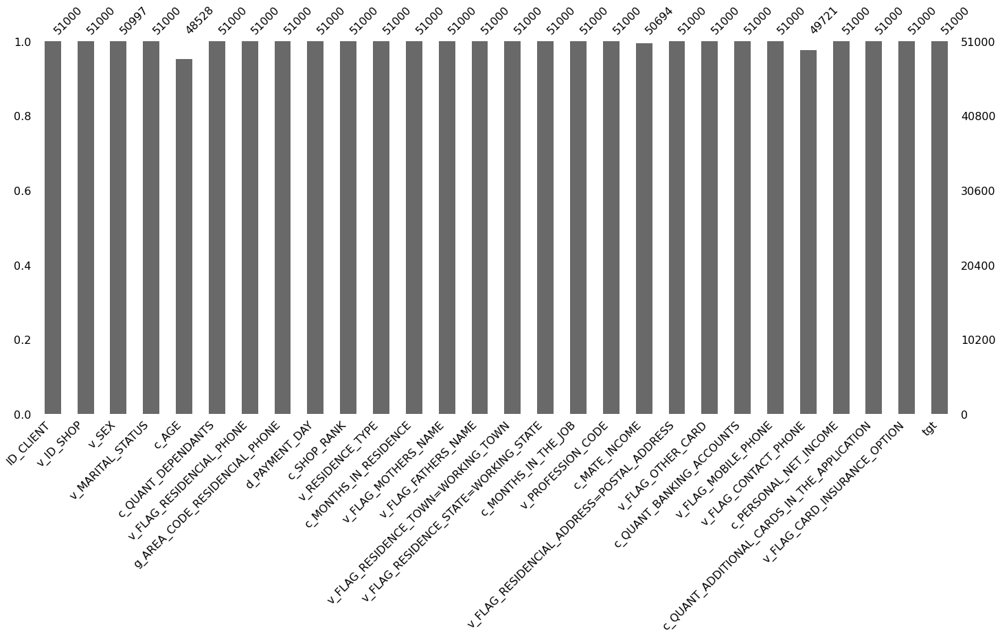

In [38]:
msno.bar(df)

<AxesSubplot:>

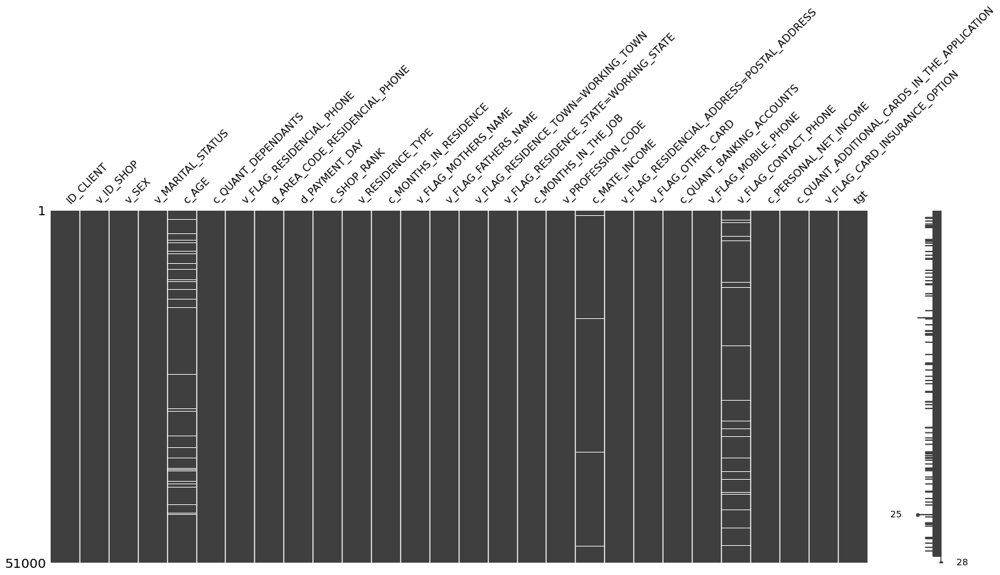

In [39]:
msno.matrix(df)

In [40]:
completitud = pd.DataFrame(df.isnull().sum())
completitud.reset_index(inplace=True)
completitud=completitud.rename(columns={'index':'columna', 0:'total faltantes'})
completitud['completitud']=(1-completitud['total faltantes']/df.shape[0]) * 100
completitud=completitud.sort_values(by='completitud', ascending=True)
completitud

,columna,total faltantes,completitud
4,c_AGE,2472,95.152941
23,v_FLAG_CONTACT_PHONE,1279,97.492157
18,c_MATE_INCOME,306,99.400000
2,v_SEX,3,99.994118
0,ID_CLIENT,0,100.000000
25,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,0,100.000000
24,c_PERSONAL_NET_INCOME,0,100.000000
22,v_FLAG_MOBILE_PHONE,0,100.000000
21,c_QUANT_BANKING_ACCOUNTS,0,100.000000
20,v_FLAG_OTHER_CARD,0,100.000000


Las variables t_personal_reference_#1 y #2 no cumplen con el mínimo de 80%, sin embargo, en vez de ser eliminadas, las voy a transformar a un 0 si es vacío, 1 caso contrario para averiguar si aporte valor de información el hecho de tener o no referencias personales

Con esta transformación esas variables pasan a ser variables de tipo categóricas y se re etiquetan

In [41]:
df.head()

,ID_CLIENT,v_ID_SHOP,v_SEX,v_MARITAL_STATUS,c_AGE,c_QUANT_DEPENDANTS,v_FLAG_RESIDENCIAL_PHONE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,v_RESIDENCE_TYPE,c_MONTHS_IN_RESIDENCE,v_FLAG_MOTHERS_NAME,v_FLAG_FATHERS_NAME,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,v_FLAG_RESIDENCE_STATE=WORKING_STATE,c_MONTHS_IN_THE_JOB,v_PROFESSION_CODE,c_MATE_INCOME,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,v_FLAG_OTHER_CARD,c_QUANT_BANKING_ACCOUNTS,v_FLAG_MOBILE_PHONE,v_FLAG_CONTACT_PHONE,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,v_FLAG_CARD_INSURANCE_OPTION,tgt
0,2,15,F,S,18.0,0,Y,31,20,0,P,216,Y,Y,Y,Y,12,853,0.0,Y,N,0,N,N,300.0,0,N,0
1,4,12,F,C,NaN,0,N,31,25,0,P,180,Y,Y,N,Y,24,35,0.0,Y,N,0,N,N,304.0,0,N,0
2,5,16,F,S,28.0,0,Y,31,25,0,,12,Y,Y,Y,Y,12,24,0.0,Y,N,0,N,N,250.0,0,N,0
3,6,24,M,S,26.0,0,N,31,28,0,P,180,Y,Y,N,Y,0,999,0.0,Y,N,0,N,N,800.0,0,N,0
4,7,55,F,S,22.0,0,Y,31,12,0,A,0,Y,Y,Y,Y,48,999,0.0,Y,N,0,N,N,410.0,0,N,0


Es el único paso de completitud que puede resolverse desde el punto de vista de la calidad de datos, para las demás variables con datos faltantes se aplicarán técnicas diferentes en pasos subsecuentes

In [42]:
df.filter(like='c_')

,c_AGE,c_QUANT_DEPENDANTS,c_SHOP_RANK,c_MONTHS_IN_RESIDENCE,c_MONTHS_IN_THE_JOB,c_MATE_INCOME,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION
0,18.0,0,0,216,12,0.0,0,300.0,0
1,NaN,0,0,180,24,0.0,0,304.0,0
2,28.0,0,0,12,12,0.0,0,250.0,0
3,26.0,0,0,180,0,0.0,0,800.0,0
4,22.0,0,0,0,48,0.0,0,410.0,0
...,...,...,...,...,...,...,...,...,...
50995,72.0,0,0,120,12,0.0,0,400.0,0
50996,31.0,0,0,240,72,0.0,0,900.0,0
50997,51.0,0,0,12,24,0.0,0,280.0,0
50998,71.0,0,0,300,0,0.0,0,1100.0,0


Encotramos 8 variables de tipo continuo que por ser unidades enteras se convierten a tipo de dato entero

In [43]:
df['c_QUANT_DEPENDANTS'] = df['c_QUANT_DEPENDANTS'].astype(int)
df['c_SHOP_RANK'] = df['c_SHOP_RANK'].astype(int)
df['c_MONTHS_IN_RESIDENCE'] = df['c_MONTHS_IN_RESIDENCE'].astype(int)
df['c_MONTHS_IN_THE_JOB'] = df['c_MONTHS_IN_THE_JOB'].astype(int)
df['c_QUANT_BANKING_ACCOUNTS'] = df['c_QUANT_BANKING_ACCOUNTS'].astype(int)
# df['c_PERSONAL_NET_INCOME'] = df['c_PERSONAL_NET_INCOME'].astype(int)
df['c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION'] = df['c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION'].astype(int)
# df['c_MATE_INCOME'] = df['c_MATE_INCOME'].astype(int)
df['tgt'] = df['tgt'].astype(int)

El personal net income tiene un formato ditinto, por lo que se seguiran pasos adicionales para su conversión a entero

In [44]:
df['c_PERSONAL_NET_INCOME'].isnull().sum()

0

In [45]:
df['c_PERSONAL_NET_INCOME'] = df['c_PERSONAL_NET_INCOME'].map(lambda x : str(x))

In [46]:
df['c_PERSONAL_NET_INCOME'] = df['c_PERSONAL_NET_INCOME'].map(lambda x: 0 if x == 'n.a.' else float(x))

In [47]:
df['c_PERSONAL_NET_INCOME'] = df['c_PERSONAL_NET_INCOME'].map(lambda x: int(x))

El mate income también tiene un formato no conveniente, por lo que se realizan transformaciones adicionales

In [48]:
df['c_MATE_INCOME'].isnull().sum()

306

In [49]:
df['c_MATE_INCOME'].unique()

array([0.0000e+00, 8.0000e+02,        nan, 1.2000e+03, 1.0000e+03,
       8.9000e+02, 9.9600e+02, 3.2000e+03, 4.6000e+02, 2.0000e+02,
       1.8000e+03, 4.5000e+02, 1.5000e+03, 3.5000e+02, 9.9000e+02,
       3.0000e+03, 2.5000e+03, 3.5700e+02, 4.9500e+02, 4.0000e+02,
       5.6000e+02, 7.5000e+02, 1.6000e+03, 4.4240e+03, 9.0000e+02,
       9.5000e+02, 8.7700e+02, 1.8000e+02, 6.0000e+02, 8.5200e+02,
       1.1100e+03, 2.4400e+02, 3.0000e+02, 1.0360e+03, 3.3500e+02,
       5.0000e+02, 4.2800e+02, 6.8900e+02, 3.1500e+02, 2.4720e+03,
       5.8200e+02, 5.8000e+02, 1.4000e+03, 2.0760e+03, 7.0000e+02,
       1.9600e+02, 1.9860e+03, 7.0300e+02, 5.4300e+02, 3.4000e+03,
       1.1000e+03, 2.2900e+02, 2.7000e+02, 5.4000e+02, 7.2700e+02,
       1.0770e+03, 7.6100e+02, 2.5170e+03, 1.7450e+03, 4.4800e+02,
       2.4000e+02, 1.4130e+03, 4.0000e+03, 2.3300e+02, 1.6620e+03,
       1.0750e+03, 3.1000e+03, 2.4000e+03, 3.6000e+03, 5.0500e+02,
       2.8000e+03, 4.3100e+02, 3.7000e+02, 3.2400e+02, 5.0000e

In [50]:
df.dropna(subset=['c_MATE_INCOME'], inplace=True)

In [51]:
df['c_MATE_INCOME'] = df['c_MATE_INCOME'].map(lambda x : str(x))

In [52]:
df['c_MATE_INCOME'] = df['c_MATE_INCOME'].map(lambda x: 0 if x == np.nan else float(x))

In [53]:
df['c_MATE_INCOME'] = df['c_MATE_INCOME'].map(lambda x: int(x))

In [54]:
df.head()

,ID_CLIENT,v_ID_SHOP,v_SEX,v_MARITAL_STATUS,c_AGE,c_QUANT_DEPENDANTS,v_FLAG_RESIDENCIAL_PHONE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,v_RESIDENCE_TYPE,c_MONTHS_IN_RESIDENCE,v_FLAG_MOTHERS_NAME,v_FLAG_FATHERS_NAME,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,v_FLAG_RESIDENCE_STATE=WORKING_STATE,c_MONTHS_IN_THE_JOB,v_PROFESSION_CODE,c_MATE_INCOME,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,v_FLAG_OTHER_CARD,c_QUANT_BANKING_ACCOUNTS,v_FLAG_MOBILE_PHONE,v_FLAG_CONTACT_PHONE,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,v_FLAG_CARD_INSURANCE_OPTION,tgt
0,2,15,F,S,18.0,0,Y,31,20,0,P,216,Y,Y,Y,Y,12,853,0,Y,N,0,N,N,300,0,N,0
1,4,12,F,C,NaN,0,N,31,25,0,P,180,Y,Y,N,Y,24,35,0,Y,N,0,N,N,304,0,N,0
2,5,16,F,S,28.0,0,Y,31,25,0,,12,Y,Y,Y,Y,12,24,0,Y,N,0,N,N,250,0,N,0
3,6,24,M,S,26.0,0,N,31,28,0,P,180,Y,Y,N,Y,0,999,0,Y,N,0,N,N,800,0,N,0
4,7,55,F,S,22.0,0,Y,31,12,0,A,0,Y,Y,Y,Y,48,999,0,Y,N,0,N,N,410,0,N,0


In [55]:
df['c_AGE'].unique()

array([ 18.,  nan,  28.,  26.,  22.,  21.,  27.,  57.,  32.,  36.,  49.,
        44.,  46.,  17.,  20.,  41.,  64.,  71.,  24.,  23.,  40.,  31.,
        30.,  39.,  55.,  66.,  35.,  19.,  42.,  53.,  62.,  38.,  75.,
        58.,  34.,  50.,  61.,  56.,  45.,  51.,  37.,  48.,  52.,  25.,
        43.,  47.,  74.,  29.,  54.,  33.,  60.,  59.,  72.,  65.,  69.,
        73.,  67.,  76., 318.,  63.,  77.,  70.,  68., 300.,  80.,  86.,
        15., 132.,  82., 282.,  78., 384.,  79., 186.,  16., 126.,  88.,
        83., 198., 144.,  81., 138., 210., 240., 222., 354., 114.,  84.,
       168., 192., 120., 246., 372.,  95., 264.,  87.,  96.,  93.,  92.,
        89.,  91.,  98.,  99.,  85.,  97.,  94.,  90.])

La variable que corresponde a la edad tiene valores que se salen del rango aceptable (arriba de 100) por lo que se eliminarán estos registros.
Para la parte de detección de datos anómalos en esta variable no nos sirven esos registros y no se pueden imputar debido a que se puede sesgar si se hace a la ligera

In [56]:
df[df['c_AGE'] > 100].shape

(28, 28)

In [57]:
df.drop(df[df['c_AGE'] > 100].index, inplace=True)

In [58]:
df['c_AGE'].value_counts()

20.0    2409
19.0    2339
21.0    2124
22.0    1813
18.0    1726
23.0    1606
24.0    1481
25.0    1388
28.0    1325
35.0    1272
26.0    1262
27.0    1261
37.0    1255
36.0    1250
30.0    1225
34.0    1221
38.0    1192
33.0    1171
39.0    1147
29.0    1147
32.0    1136
31.0    1109
40.0    1105
41.0    1045
42.0    1004
43.0     976
44.0     907
45.0     899
46.0     857
47.0     758
48.0     731
49.0     646
50.0     611
51.0     584
52.0     537
53.0     514
54.0     480
56.0     353
55.0     352
57.0     346
58.0     301
59.0     293
61.0     275
60.0     254
62.0     242
63.0     218
65.0     208
64.0     206
66.0     172
67.0     162
68.0     139
71.0     131
70.0     121
69.0     116
72.0      96
17.0      80
73.0      71
74.0      67
75.0      58
76.0      46
78.0      31
79.0      30
77.0      28
81.0      21
82.0      19
80.0      19
93.0      18
88.0      18
95.0      17
86.0      16
89.0      15
92.0      15
16.0      14
94.0      14
85.0      13
87.0      13
83.0      13

In [59]:
df['c_AGE'] = df['c_AGE'].astype(float)

In [60]:
df.shape[0]

50666

In [61]:
(df['c_AGE'].isnull().sum() / df.shape[0]) * 100

4.845458492874907

Como estamos en la parte de calidad de datos y los datos faltantes en la edad son menos del 5% de la información y no es factible imputar en este momento con alfguna medida de tendencia central u otra técnica, procederemos a eliminar los registros

In [62]:
df.dropna(subset=['c_AGE'], inplace=True)

In [63]:
df['c_AGE'].isnull().sum()

0

In [64]:
df['c_AGE'] = df['c_AGE'].astype(int)

Limpieza de variables categóricas

In [65]:
df.filter(like='v_')

,v_ID_SHOP,v_SEX,v_MARITAL_STATUS,v_FLAG_RESIDENCIAL_PHONE,v_RESIDENCE_TYPE,v_FLAG_MOTHERS_NAME,v_FLAG_FATHERS_NAME,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,v_FLAG_RESIDENCE_STATE=WORKING_STATE,v_PROFESSION_CODE,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,v_FLAG_OTHER_CARD,v_FLAG_MOBILE_PHONE,v_FLAG_CONTACT_PHONE,v_FLAG_CARD_INSURANCE_OPTION
0,15,F,S,Y,P,Y,Y,Y,Y,853,Y,N,N,N,N
2,16,F,S,Y,,Y,Y,Y,Y,24,Y,N,N,N,N
3,24,M,S,N,P,Y,Y,N,Y,999,Y,N,N,N,N
4,55,F,S,Y,A,Y,Y,Y,Y,999,Y,N,N,N,N
5,6,F,C,y,A,Y,Y,Y,Y,40,Y,N,N,NaN,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50995,16,F,S,Y,C,Y,Y,Y,Y,219,Y,N,N,N,N
50996,23,F,S,Y,P,Y,Y,N,Y,131,Y,N,N,N,N
50997,4,F,C,Y,P,Y,Y,N,Y,999,Y,N,N,N,N
50998,25,F,C,Y,P,Y,Y,Y,Y,32,Y,N,N,N,N


In [66]:
df['v_ID_SHOP'].unique()

array([15, 16, 24, 55,  6,  3, 23, 12,  7, 19,  1, 21, 25, 20, 22, 66, 13,
       14, 17,  8, 10, 11, 18,  4,  2,  5,  9, 96, 50, 81, 77])

In [67]:
df['v_SEX'].unique()

array(['F', 'M', 'n.a', nan], dtype=object)

In [68]:
df.loc[(df['v_SEX'] == 'F') | (df['v_SEX'] == 'M')].shape[0]

47461

In [69]:
100 - df.loc[(df['v_SEX'] == 'F') | (df['v_SEX'] == 'M')].shape[0] / df.shape[0] * 100

1.5556615710107735

In [70]:
# Aprovechando la limpieza que se tiene que hacer de esta variable, se puede realizar de una vez la transformación
# de la misma
# Los valores faltantes se pueden imputar como una nueva categoría dada la naturaleza de la variable
def limpia_sexo(x):
    """
    Para valores femeninos se retorna 0
    Para valores masculinos se retorna 1
    Para diferente caso se retornará 3
    """
    if x == 'F':
        return 0
    elif x == 'M':
        return 1
    else:
        return 2

In [71]:
df['v_SEX'] = df['v_SEX'].map(limpia_sexo)

In [72]:
df.v_SEX.unique()

array([0, 1, 2])

In [73]:
df['v_SEX'].value_counts()

0    33037
1    14424
2      750
Name: v_SEX, dtype: int64

In [74]:
df['v_MARITAL_STATUS'].value_counts()

S     24304
C     16571
O      2666
V      2329
D      2064
S       149
C        92
O        13
V        12
D        11
Name: v_MARITAL_STATUS, dtype: int64

In [75]:
df['v_MARITAL_STATUS'].unique()

array(['S', 'C', 'O', 'V', 'D', 'S ', 'C ', 'D ', 'V ', 'O '],
      dtype=object)

In [76]:
df['v_MARITAL_STATUS'] = df['v_MARITAL_STATUS'].map(lambda x:x.strip().lstrip().replace('\n',''))

In [77]:
df['v_MARITAL_STATUS'].unique()

array(['S', 'C', 'O', 'V', 'D'], dtype=object)

In [78]:
# v_FLAG_RESIDENCIAL_PHONE
df['v_FLAG_RESIDENCIAL_PHONE'].unique()

array(['Y', 'N', 'y', 'n'], dtype=object)

In [79]:
df['v_FLAG_RESIDENCIAL_PHONE'] = df['v_FLAG_RESIDENCIAL_PHONE'].map(lambda x:x.lower())

In [80]:
df['v_FLAG_RESIDENCIAL_PHONE'].unique()

array(['y', 'n'], dtype=object)

In [81]:
# v_RESIDENCE_TYPE
df['v_RESIDENCE_TYPE'].unique()

array(['P', ' ', 'A', 'O', 'C', ' a', 'p', ' p', 'P ', ' c', 'C ', ' o',
       'O ', 'A ', 'a', 'c', 'p ', 'o'], dtype=object)

In [82]:
df['v_RESIDENCE_TYPE'] = df['v_RESIDENCE_TYPE'].map(lambda x:x.strip().lstrip().replace('\n', '').lower())

In [83]:
df['v_RESIDENCE_TYPE'].unique()

array(['p', '', 'a', 'o', 'c'], dtype=object)

In [84]:
df[df['v_RESIDENCE_TYPE'] == '']

,ID_CLIENT,v_ID_SHOP,v_SEX,v_MARITAL_STATUS,c_AGE,c_QUANT_DEPENDANTS,v_FLAG_RESIDENCIAL_PHONE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,v_RESIDENCE_TYPE,c_MONTHS_IN_RESIDENCE,v_FLAG_MOTHERS_NAME,v_FLAG_FATHERS_NAME,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,v_FLAG_RESIDENCE_STATE=WORKING_STATE,c_MONTHS_IN_THE_JOB,v_PROFESSION_CODE,c_MATE_INCOME,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,v_FLAG_OTHER_CARD,c_QUANT_BANKING_ACCOUNTS,v_FLAG_MOBILE_PHONE,v_FLAG_CONTACT_PHONE,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,v_FLAG_CARD_INSURANCE_OPTION,tgt
2,5,16,0,S,28,0,y,31,25,0,,12,Y,Y,Y,Y,12,24,0,Y,N,0,N,N,250,0,N,0
10,14,24,1,C,36,0,y,31,12,0,,120,Y,Y,Y,Y,36,15,0,Y,N,0,N,N,1987,1,N,0
11,15,7,1,S,26,0,y,27,1,0,,240,Y,Y,N,Y,12,26,0,Y,N,0,N,N,1000,0,N,0
14,19,55,0,V,46,0,n,50,12,0,,360,Y,Y,N,Y,120,704,0,Y,N,0,N,N,520,0,N,0
24,30,1,0,S,46,0,y,31,8,0,,72,Y,Y,N,Y,12,801,0,Y,N,0,N,N,442,0,N,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49943,49723,12,0,S,38,0,y,31,12,0,,300,Y,Y,Y,Y,0,855,0,Y,N,0,N,N,190,0,N,0
49947,49755,24,0,S,30,0,y,31,12,0,,240,Y,Y,N,Y,300,725,0,Y,N,0,N,N,629,0,N,1
49961,49857,1,0,S,42,0,y,50,18,0,,480,Y,N,N,Y,12,205,0,Y,N,0,N,N,302,0,N,0
49963,49861,12,0,S,43,0,y,31,25,0,,168,Y,Y,Y,Y,216,205,0,Y,N,0,N,N,360,0,N,0


In [85]:
7114/df.shape[0]

0.1475596855489411

El porcentaje de datos faltantes en esta variable es bastante elevado como para simplemente descartar estos registros, por ende
por el momento se sustituirá por una letra nueva y más tarde con una técnica para valores faltantes se tratará

In [86]:
df['v_RESIDENCE_TYPE'] = df['v_RESIDENCE_TYPE'].map(lambda x: 'x' if x == '' else x)

In [87]:
df['v_RESIDENCE_TYPE'].unique()

array(['p', 'x', 'a', 'o', 'c'], dtype=object)

In [88]:
# v_FLAG_MOTHERS_NAME and v_FLAG_FATHERS_NAME
df['v_FLAG_MOTHERS_NAME'].unique()

array(['Y', 'N'], dtype=object)

In [89]:
df['v_FLAG_FATHERS_NAME'].unique()

array(['Y', 'N'], dtype=object)

In [90]:
# v_FLAG_RESIDENCE_TOWN=WORKING_TOWN
df['v_FLAG_RESIDENCE_TOWN=WORKING_TOWN'].unique()

array(['Y', 'N'], dtype=object)

In [91]:
df.filter(like='v_')

,v_ID_SHOP,v_SEX,v_MARITAL_STATUS,v_FLAG_RESIDENCIAL_PHONE,v_RESIDENCE_TYPE,v_FLAG_MOTHERS_NAME,v_FLAG_FATHERS_NAME,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,v_FLAG_RESIDENCE_STATE=WORKING_STATE,v_PROFESSION_CODE,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,v_FLAG_OTHER_CARD,v_FLAG_MOBILE_PHONE,v_FLAG_CONTACT_PHONE,v_FLAG_CARD_INSURANCE_OPTION
0,15,0,S,y,p,Y,Y,Y,Y,853,Y,N,N,N,N
2,16,0,S,y,x,Y,Y,Y,Y,24,Y,N,N,N,N
3,24,1,S,n,p,Y,Y,N,Y,999,Y,N,N,N,N
4,55,0,S,y,a,Y,Y,Y,Y,999,Y,N,N,N,N
5,6,0,C,y,a,Y,Y,Y,Y,40,Y,N,N,NaN,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50995,16,0,S,y,c,Y,Y,Y,Y,219,Y,N,N,N,N
50996,23,0,S,y,p,Y,Y,N,Y,131,Y,N,N,N,N
50997,4,0,C,y,p,Y,Y,N,Y,999,Y,N,N,N,N
50998,25,0,C,y,p,Y,Y,Y,Y,32,Y,N,N,N,N


In [92]:
# v_FLAG_RESIDENCE_STATE=WORKING_STATE
df['v_FLAG_RESIDENCE_STATE=WORKING_STATE'].unique()

array(['Y', 'N'], dtype=object)

In [93]:
# v_PROFESSION_CODE
df['v_PROFESSION_CODE'].unique()

array([853,  24, 999,  40, 950,  13, 165,  15,  26, 703, 135, 704,  38,
        34,  39,  72, 801,  30, 713, 305, 653, 261,  43, 205, 918, 251,
       720,  62,  53,  41,   2, 131, 992, 514,   1, 132, 501,  61, 158,
       263,  60,  70, 855, 110, 213, 807, 717, 656, 712, 865, 707,  63,
       863, 100, 118, 806, 125, 265, 117, 654, 266, 167, 254, 706, 905,
       222, 202, 123, 702, 302, 166, 522,  35, 210, 253,  18, 139, 113,
       804, 920, 301, 725,  49,   4, 218,  89, 515, 255,  29, 108,  19,
       134, 521, 508, 130,  65, 915, 732,  17, 262, 711,  31, 155, 864,
       721, 133, 163, 952, 505, 953, 105, 310, 922, 151,  66, 718,  36,
         8, 312, 137,  52,  99, 107, 223, 159,  32,  12,  79,  25, 129,
        64, 650, 264, 657, 250, 731, 512,  44, 453, 203,  77, 991, 908,
        69, 164, 140, 652,  68,  78, 527, 923, 513, 307, 503,  51, 912,
       504, 211, 655, 524, 921, 401, 136,  55, 911, 916, 525, 116,  48,
       351,  42,  88, 219, 220, 904, 127, 506, 168,  33, 716,  5

In [94]:
df['v_PROFESSION_CODE'] = df['v_PROFESSION_CODE'].astype(int)

In [95]:
# v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS
df ['v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS'].unique()

array(['Y', 'N'], dtype=object)

In [96]:
df['v_FLAG_OTHER_CARD'].unique()

array(['N'], dtype=object)

Es una variable unaria, no aporta información, por lo que se elimina

In [97]:
df.drop(['v_FLAG_OTHER_CARD'], axis=1 ,inplace=True)

In [98]:
# v_FLAG_MOBILE_PHONE
df['v_FLAG_MOBILE_PHONE'].unique()

array(['N'], dtype=object)

Variable unaria, se elimina

In [99]:
df.drop(['v_FLAG_MOBILE_PHONE'], axis=1, inplace=True)

In [100]:
# v_FLAG_CONTACT_PHONE
df['v_FLAG_CONTACT_PHONE'].unique()

array(['N', nan], dtype=object)

In [101]:
df['v_FLAG_CONTACT_PHONE'].isnull().sum()

1206

No hay suficiente evidencia para pensar que los valores faltantes son opuestos al valor predominante, aparte por la naturaleza
de la variable no aporta mucha información y se sospecha de ser una variable uanria, por lo que se elimina sin más!

In [102]:
df.drop(['v_FLAG_CONTACT_PHONE'], axis=1, inplace=True)

In [103]:
# v_FLAG_CARD_INSURANCE_OPTION
df['v_FLAG_CARD_INSURANCE_OPTION'].unique()

array(['N'], dtype=object)

Variable unaria, se elimina

In [104]:
df.drop(['v_FLAG_CARD_INSURANCE_OPTION'], axis=1, inplace=True)

#### Limpieza de otras variables

In [105]:
df.head()

,ID_CLIENT,v_ID_SHOP,v_SEX,v_MARITAL_STATUS,c_AGE,c_QUANT_DEPENDANTS,v_FLAG_RESIDENCIAL_PHONE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,v_RESIDENCE_TYPE,c_MONTHS_IN_RESIDENCE,v_FLAG_MOTHERS_NAME,v_FLAG_FATHERS_NAME,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,v_FLAG_RESIDENCE_STATE=WORKING_STATE,c_MONTHS_IN_THE_JOB,v_PROFESSION_CODE,c_MATE_INCOME,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,tgt
0,2,15,0,S,18,0,y,31,20,0,p,216,Y,Y,Y,Y,12,853,0,Y,0,300,0,0
2,5,16,0,S,28,0,y,31,25,0,x,12,Y,Y,Y,Y,12,24,0,Y,0,250,0,0
3,6,24,1,S,26,0,n,31,28,0,p,180,Y,Y,N,Y,0,999,0,Y,0,800,0,0
4,7,55,0,S,22,0,y,31,12,0,a,0,Y,Y,Y,Y,48,999,0,Y,0,410,0,0
5,8,6,0,C,21,0,y,23,28,0,a,24,Y,Y,Y,Y,12,40,800,Y,0,248,0,0


In [106]:
df['g_AREA_CODE_RESIDENCIAL_PHONE'].unique()

array([31, 23, 27, 50, 34,  5,  1, 49, 24, 32, 68, 62, 56, 33, 15, 41, 42,
       38, 46, 44, 45,  6, 17, 12,  2, 14, 39, 22, 43,  8, 59,  7, 52, 37,
       36, 35, 26, 69, 25,  3, 40, 67, 30, 13, 48, 11, 60, 21, 64, 51, 63,
       47, 70, 57, 65,  4, 29, 18, 54, 53,  9, 61, 58, 20, 28])

In [107]:
df['g_AREA_CODE_RESIDENCIAL_PHONE'] = df['g_AREA_CODE_RESIDENCIAL_PHONE'].astype(int)

In [108]:
df.drop(['ID_CLIENT'], axis=1, inplace=True)

In [109]:
df['tgt'].unique()

array([0, 1])

Cruce con tabla de ocupaciones

In [110]:
ocupaciones

,PROFESSION_CODE,PROFESSION
0,999,Healthcare Practitioners and Technical
1,950,Healthcare Practitioners and Technical
2,13,Educational Instruction and Library
3,205,Production
4,703,Educational Instruction and Library
...,...,...
290,152,Production
291,516,"Life, Physical, and Social Science"
292,50,Educational Instruction and Library
293,850,"Life, Physical, and Social Science"


In [111]:
orden_original=list(df.columns)

In [112]:
orden_original

['v_ID_SHOP',
 'v_SEX',
 'v_MARITAL_STATUS',
 'c_AGE',
 'c_QUANT_DEPENDANTS',
 'v_FLAG_RESIDENCIAL_PHONE',
 'g_AREA_CODE_RESIDENCIAL_PHONE',
 'd_PAYMENT_DAY',
 'c_SHOP_RANK',
 'v_RESIDENCE_TYPE',
 'c_MONTHS_IN_RESIDENCE',
 'v_FLAG_MOTHERS_NAME',
 'v_FLAG_FATHERS_NAME',
 'v_FLAG_RESIDENCE_TOWN=WORKING_TOWN',
 'v_FLAG_RESIDENCE_STATE=WORKING_STATE',
 'c_MONTHS_IN_THE_JOB',
 'v_PROFESSION_CODE',
 'c_MATE_INCOME',
 'v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS',
 'c_QUANT_BANKING_ACCOUNTS',
 'c_PERSONAL_NET_INCOME',
 'c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION',
 'tgt']

In [113]:
df = df.merge(ocupaciones, right_on='PROFESSION_CODE',left_on='v_PROFESSION_CODE',how='left')

In [114]:
df.head()

,v_ID_SHOP,v_SEX,v_MARITAL_STATUS,c_AGE,c_QUANT_DEPENDANTS,v_FLAG_RESIDENCIAL_PHONE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,v_RESIDENCE_TYPE,c_MONTHS_IN_RESIDENCE,v_FLAG_MOTHERS_NAME,v_FLAG_FATHERS_NAME,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,v_FLAG_RESIDENCE_STATE=WORKING_STATE,c_MONTHS_IN_THE_JOB,v_PROFESSION_CODE,c_MATE_INCOME,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,tgt,PROFESSION_CODE,PROFESSION
0,15,0,S,18,0,y,31,20,0,p,216,Y,Y,Y,Y,12,853,0,Y,0,300,0,0,853,Educational Instruction and Library
1,16,0,S,28,0,y,31,25,0,x,12,Y,Y,Y,Y,12,24,0,Y,0,250,0,0,24,Healthcare Practitioners and Technical
2,24,1,S,26,0,n,31,28,0,p,180,Y,Y,N,Y,0,999,0,Y,0,800,0,0,999,Healthcare Practitioners and Technical
3,55,0,S,22,0,y,31,12,0,a,0,Y,Y,Y,Y,48,999,0,Y,0,410,0,0,999,Healthcare Practitioners and Technical
4,6,0,C,21,0,y,23,28,0,a,24,Y,Y,Y,Y,12,40,800,Y,0,248,0,0,40,Healthcare Practitioners and Technical


In [115]:
df1 = df.copy()

In [116]:
df1 = df1.reindex(columns = ['v_ID_SHOP',
 'v_SEX',
 'v_MARITAL_STATUS',
 'c_AGE',
 'c_QUANT_DEPENDANTS',
 'v_FLAG_RESIDENCIAL_PHONE',
 'g_AREA_CODE_RESIDENCIAL_PHONE',
 'd_PAYMENT_DAY',
 'c_SHOP_RANK',
 'v_RESIDENCE_TYPE',
 'c_MONTHS_IN_RESIDENCE',
 'v_FLAG_MOTHERS_NAME',
 'v_FLAG_FATHERS_NAME',
 'v_FLAG_RESIDENCE_TOWN=WORKING_TOWN',
 'v_FLAG_RESIDENCE_STATE=WORKING_STATE',
 'c_MONTHS_IN_THE_JOB',
 'v_PROFESSION_CODE', 'PROFESSION',
 'c_MATE_INCOME',
 'v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS',
 'c_QUANT_BANKING_ACCOUNTS',
 'c_PERSONAL_NET_INCOME',
 'c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION',
 'tgt'])

In [117]:
df1.head(10)

,v_ID_SHOP,v_SEX,v_MARITAL_STATUS,c_AGE,c_QUANT_DEPENDANTS,v_FLAG_RESIDENCIAL_PHONE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,v_RESIDENCE_TYPE,c_MONTHS_IN_RESIDENCE,v_FLAG_MOTHERS_NAME,v_FLAG_FATHERS_NAME,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,v_FLAG_RESIDENCE_STATE=WORKING_STATE,c_MONTHS_IN_THE_JOB,v_PROFESSION_CODE,PROFESSION,c_MATE_INCOME,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,tgt
0,15,0,S,18,0,y,31,20,0,p,216,Y,Y,Y,Y,12,853,Educational Instruction and Library,0,Y,0,300,0,0
1,16,0,S,28,0,y,31,25,0,x,12,Y,Y,Y,Y,12,24,Healthcare Practitioners and Technical,0,Y,0,250,0,0
2,24,1,S,26,0,n,31,28,0,p,180,Y,Y,N,Y,0,999,Healthcare Practitioners and Technical,0,Y,0,800,0,0
3,55,0,S,22,0,y,31,12,0,a,0,Y,Y,Y,Y,48,999,Healthcare Practitioners and Technical,0,Y,0,410,0,0
4,6,0,C,21,0,y,23,28,0,a,24,Y,Y,Y,Y,12,40,Healthcare Practitioners and Technical,800,Y,0,248,0,0
5,3,0,S,27,0,y,31,20,0,a,0,Y,Y,Y,Y,0,950,Healthcare Practitioners and Technical,0,Y,0,1000,0,1
6,23,0,C,57,0,y,31,12,0,p,24,Y,Y,N,Y,96,13,Educational Instruction and Library,0,Y,0,856,0,0
7,12,0,C,32,0,y,31,12,0,p,24,Y,Y,N,Y,0,165,"Life, Physical, and Social Science",0,Y,0,700,0,0
8,24,1,C,36,0,y,31,12,0,x,120,Y,Y,Y,Y,36,15,"Life, Physical, and Social Science",0,Y,0,1987,1,0
9,7,1,S,26,0,y,27,1,0,x,240,Y,Y,N,Y,12,26,Healthcare Practitioners and Technical,0,Y,0,1000,0,0


In [118]:
del(df) # Eliminar el DF original para liberar memoria
df = df1.copy()
del(df1)

In [119]:
df.rename(columns={'PROFESSION':'t_PROFESSION'}, inplace=True)

### Normalización de variables

Primero identificamos esas variables que tienen mucha variabilidad que son básicamente las variables numéricas

In [120]:
df.head()

,v_ID_SHOP,v_SEX,v_MARITAL_STATUS,c_AGE,c_QUANT_DEPENDANTS,v_FLAG_RESIDENCIAL_PHONE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,v_RESIDENCE_TYPE,c_MONTHS_IN_RESIDENCE,v_FLAG_MOTHERS_NAME,v_FLAG_FATHERS_NAME,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,v_FLAG_RESIDENCE_STATE=WORKING_STATE,c_MONTHS_IN_THE_JOB,v_PROFESSION_CODE,t_PROFESSION,c_MATE_INCOME,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,tgt
0,15,0,S,18,0,y,31,20,0,p,216,Y,Y,Y,Y,12,853,Educational Instruction and Library,0,Y,0,300,0,0
1,16,0,S,28,0,y,31,25,0,x,12,Y,Y,Y,Y,12,24,Healthcare Practitioners and Technical,0,Y,0,250,0,0
2,24,1,S,26,0,n,31,28,0,p,180,Y,Y,N,Y,0,999,Healthcare Practitioners and Technical,0,Y,0,800,0,0
3,55,0,S,22,0,y,31,12,0,a,0,Y,Y,Y,Y,48,999,Healthcare Practitioners and Technical,0,Y,0,410,0,0
4,6,0,C,21,0,y,23,28,0,a,24,Y,Y,Y,Y,12,40,Healthcare Practitioners and Technical,800,Y,0,248,0,0


Para evitar revisar una por una, se calcularán los estadísticos de estas variables para tomar una decisión del modo en el que se van a normalizar

In [121]:
df.describe()

,v_ID_SHOP,v_SEX,c_AGE,c_QUANT_DEPENDANTS,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,c_MONTHS_IN_RESIDENCE,c_MONTHS_IN_THE_JOB,v_PROFESSION_CODE,c_MATE_INCOME,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,tgt
count,48211.000000,48211.000000,48211.000000,48211.0,48211.000000,48211.000000,48211.000000,48211.000000,48211.000000,48211.000000,48211.000000,48211.0,4.821100e+04,48211.000000,48211.000000
mean,20.829914,0.330298,35.222377,0.0,33.765033,15.351351,0.016054,153.144801,50.775300,483.245732,55.942731,0.0,8.443199e+03,0.148804,0.277986
std,14.586246,0.502314,13.812919,0.0,10.446448,7.170079,0.212529,136.418438,74.105156,382.297496,933.480227,0.0,4.417398e+05,0.403328,0.448011
min,1.000000,0.000000,15.000000,0.0,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000e+00,0.000000,0.000000
25%,12.000000,0.000000,23.000000,0.0,31.000000,9.000000,0.000000,36.000000,12.000000,79.000000,0.000000,0.0,2.700000e+02,0.000000,0.000000
50%,21.000000,0.000000,33.000000,0.0,31.000000,12.000000,0.000000,120.000000,24.000000,514.000000,0.000000,0.0,4.010000e+02,0.000000,0.000000
75%,24.000000,1.000000,44.000000,0.0,31.000000,20.000000,0.000000,240.000000,60.000000,864.000000,0.000000,0.0,7.500000e+02,0.000000,1.000000
max,96.000000,2.000000,99.000000,0.0,70.000000,28.000000,3.000000,1188.000000,1176.000000,999.000000,150000.000000,0.0,3.852910e+07,3.000000,1.000000


Gracias a los estadísticos, se descrubrió que la variable c_QUANT_DEPENDANTS es unaria, por lo que se elimina

In [122]:
df.drop('c_QUANT_DEPENDANTS', axis=1, inplace=True)

In [123]:
len(df['c_MATE_INCOME'].unique())

643

In [124]:
len(df['c_PERSONAL_NET_INCOME'].unique())

2512

In [125]:
df['c_PERSONAL_NET_INCOME'].max()

38529098

In [126]:
df['c_PERSONAL_NET_INCOME'].min()

0

In [127]:
df[(df['c_PERSONAL_NET_INCOME'] == 0) & (df['c_MATE_INCOME'] > 0)].shape

(427, 23)

In [128]:
df[(df['c_PERSONAL_NET_INCOME'] == 0) & (df['c_MATE_INCOME'] == 0)].shape

(897, 23)

Normalizar variables correspondientes a los ingresos
Para normalizar estas variables se dejará únicamente la primer cifra significativa si está si la segunda cifra significativa está por debajo de 5 y el siguiente número mayor inmediato en caso de que la segunda cifra significcativa esté por encima del 5, por ejemplo:

1344 - 1000

7893 - 7000

10340 - 10000

In [129]:
def normaliza_ingresos(x):
    if x == 0:
        return x
    aux = str(x)
    return aux[0] + '0' * (len(aux) - 1)

In [130]:
df['c_PERSONAL_NET_INCOME'] = df['c_PERSONAL_NET_INCOME'].apply(normaliza_ingresos)
df['c_MATE_INCOME'] = df['c_MATE_INCOME'].apply(normaliza_ingresos)

In [131]:
df['c_MATE_INCOME'].value_counts()

0         46278
1000        495
2000        177
500         174
400         163
300         154
600         147
800         131
700         127
900          91
200          90
3000         74
100          33
4000         27
5000         18
6000         12
7000          5
8000          3
10000         3
20000         2
30000         2
70000         1
1             1
100000        1
80000         1
50            1
Name: c_MATE_INCOME, dtype: int64

In [132]:
df['c_PERSONAL_NET_INCOME'].value_counts()

200         9884
300         8168
1000        5733
400         5456
500         4163
600         2958
100         2733
800         2233
700         2031
0           1324
900         1229
2000        1205
3000         421
4000         165
5000         102
10000         70
6000          46
1             43
7000          29
8000          28
10            19
40000         19
100000        19
20000         14
20000000      13
50000         12
20            11
60000         11
30000         10
9000           9
70000          7
200000         6
300000         5
50             5
80000          5
60             3
400000         3
3              3
80             3
40             2
90             2
30             2
800000         1
90000          1
30000000       1
7000000        1
6              1
70             1
2              1
Name: c_PERSONAL_NET_INCOME, dtype: int64

los datos son demasiado dispersos, por lo que en este punto, se conservarán tal cual para ser tratados más adelante con una técnica para valores atípicos ya que si se normalizan agrupando sin tener4 cuidado, se puede perder mucha información.

In [133]:
len(df['t_PROFESSION'].unique())

4

In [134]:
df['t_PROFESSION'].value_counts()

Healthcare Practitioners and Technical    19413
Educational Instruction and Library       12393
Production                                 8899
Life, Physical, and Social Science         7506
Name: t_PROFESSION, dtype: int64

In [135]:
df.drop('v_PROFESSION_CODE', axis=1, inplace=True)

In [136]:
df['c_MONTHS_IN_THE_JOB'].unique()

array([  12,    0,   48,   96,   36,  120,  192,   24,   60,   72,  288,
        108,  144,  168,  240,  324,  204,  252,   84,  132,  180,  216,
        156,  264,  372,  360,  228,  300,  468,  480,  312,  276,  420,
        348,  336,  780,  432,  708,  396,  612,  504,  444,  384,  408,
       1104,  456,  492,  660,  600,  684,  588, 1176,  552,  516,  852,
        576])

In [137]:
df['c_MONTHS_IN_RESIDENCE'].unique()

array([ 216,   12,  180,    0,   24,  120,  240,   72,  360,   48,   96,
        276,   36,  228,  168,  252,   60,  300,  144,  156,  288,  336,
        132,   84,  192,  492,  108,  264,  456,  384,  372,  324,  204,
        480,  612,  540,  408,  528,  396,  576,  444,  564,  420,  348,
        516,  312,  432,  600,  468,  684,  660,  624,  648,  504,  588,
        672, 1188,  720,  552,  828,  888,  840,  636,  708,  756,  696,
        732,  816,  744, 1020,  792,  900,  852,  780, 1176, 1116,  876,
        912,  804])

In [138]:
df['v_ID_SHOP'].unique()

array([15, 16, 24, 55,  6,  3, 23, 12,  7, 19,  1, 21, 25, 20, 22, 66, 13,
       14, 17,  8, 10, 11, 18,  4,  2,  5,  9, 96, 50, 81, 77])

In [139]:
df['c_AGE'].unique()

array([18, 28, 26, 22, 21, 27, 57, 32, 36, 49, 44, 46, 17, 20, 41, 64, 71,
       24, 23, 40, 31, 30, 39, 55, 66, 35, 19, 42, 53, 62, 38, 75, 58, 34,
       50, 61, 56, 45, 51, 37, 48, 52, 25, 43, 47, 74, 29, 54, 33, 60, 59,
       72, 65, 69, 73, 67, 76, 63, 77, 70, 68, 80, 86, 15, 82, 78, 79, 16,
       88, 83, 81, 84, 95, 87, 96, 93, 92, 89, 91, 98, 99, 85, 97, 94, 90])

Para finalizar el proceso de calidad de datos, liberamos la memoria de las variables que ya no se van a usar
Como resultado final tenemos

In [140]:
df.shape

(48211, 22)

registros de los

(51000, 32) originales

In [141]:
(48211/51000)*100

94.53137254901961

Conservamos el 94% de registros tras el proceso de calidad de datos

In [142]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 48211 entries, 0 to 48210
Data columns (total 22 columns):
 #   Column                                       Non-Null Count  Dtype 
---  ------                                       --------------  ----- 
 0   v_ID_SHOP                                    48211 non-null  int64 
 1   v_SEX                                        48211 non-null  int64 
 2   v_MARITAL_STATUS                             48211 non-null  object
 3   c_AGE                                        48211 non-null  int64 
 4   v_FLAG_RESIDENCIAL_PHONE                     48211 non-null  object
 5   g_AREA_CODE_RESIDENCIAL_PHONE                48211 non-null  int64 
 6   d_PAYMENT_DAY                                48211 non-null  int64 
 7   c_SHOP_RANK                                  48211 non-null  int64 
 8   v_RESIDENCE_TYPE                             48211 non-null  object
 9   c_MONTHS_IN_RESIDENCE                        48211 non-null  int64 
 10  v_FLAG_MOT

In [143]:
completitud = pd.DataFrame(df.isnull().sum())
completitud.reset_index(inplace=True)
completitud=completitud.rename(columns={'index':'columna', 0:'total faltantes'})
completitud['completitud']=(1-completitud['total faltantes']/df.shape[0]) * 100
completitud=completitud.sort_values(by='completitud', ascending=True)
completitud

,columna,total faltantes,completitud
0,v_ID_SHOP,0,100.0
19,c_PERSONAL_NET_INCOME,0,100.0
18,c_QUANT_BANKING_ACCOUNTS,0,100.0
17,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,0,100.0
16,c_MATE_INCOME,0,100.0
15,t_PROFESSION,0,100.0
14,c_MONTHS_IN_THE_JOB,0,100.0
13,v_FLAG_RESIDENCE_STATE=WORKING_STATE,0,100.0
12,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,0,100.0
11,v_FLAG_FATHERS_NAME,0,100.0


In [144]:
del(completitud)
del(ocupaciones)
del(orden_original)
del(vars_c)
del(vars_d)
del(vars_g)
del(vars_v)

# Análisis exploratorio

In [145]:
# Gráficos
import seaborn as sns
import plotly
from matplotlib import pyplot
import plotly
import plotly.graph_objects as go
import plotly.express as px
import cufflinks as cf
import stylecloud
from PIL import Image
from plotly.offline import plot,iplot

pd.options.plotting.backend = "plotly"
cf.go_offline()


In [146]:
df.head()

,v_ID_SHOP,v_SEX,v_MARITAL_STATUS,c_AGE,v_FLAG_RESIDENCIAL_PHONE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,v_RESIDENCE_TYPE,c_MONTHS_IN_RESIDENCE,v_FLAG_MOTHERS_NAME,v_FLAG_FATHERS_NAME,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,v_FLAG_RESIDENCE_STATE=WORKING_STATE,c_MONTHS_IN_THE_JOB,t_PROFESSION,c_MATE_INCOME,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,tgt
0,15,0,S,18,y,31,20,0,p,216,Y,Y,Y,Y,12,Educational Instruction and Library,0,Y,0,300,0,0
1,16,0,S,28,y,31,25,0,x,12,Y,Y,Y,Y,12,Healthcare Practitioners and Technical,0,Y,0,200,0,0
2,24,1,S,26,n,31,28,0,p,180,Y,Y,N,Y,0,Healthcare Practitioners and Technical,0,Y,0,800,0,0
3,55,0,S,22,y,31,12,0,a,0,Y,Y,Y,Y,48,Healthcare Practitioners and Technical,0,Y,0,400,0,0
4,6,0,C,21,y,23,28,0,a,24,Y,Y,Y,Y,12,Healthcare Practitioners and Technical,800,Y,0,200,0,0


/home/sqpr14_/anaconda3/envs/dss/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='d_PAYMENT_DAY', ylabel='Density'>

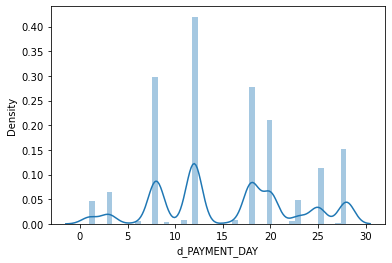

In [147]:
sns.distplot(df['d_PAYMENT_DAY'])

/home/sqpr14_/anaconda3/envs/dss/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='c_MONTHS_IN_RESIDENCE', ylabel='Density'>

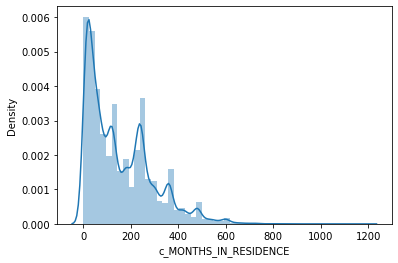

In [148]:
sns.distplot(df['c_MONTHS_IN_RESIDENCE'])

/home/sqpr14_/anaconda3/envs/dss/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='c_MONTHS_IN_THE_JOB', ylabel='Density'>

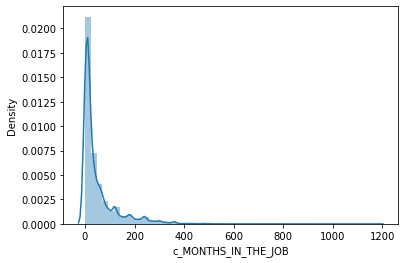

In [149]:
sns.distplot(df['c_MONTHS_IN_THE_JOB'])

/home/sqpr14_/anaconda3/envs/dss/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='c_PERSONAL_NET_INCOME', ylabel='Density'>

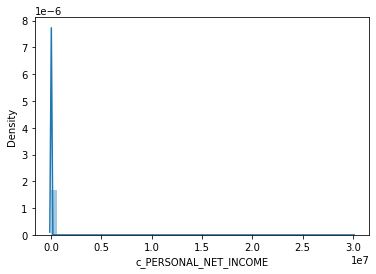

In [150]:
sns.distplot(df['c_PERSONAL_NET_INCOME'])

/home/sqpr14_/anaconda3/envs/dss/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='c_MATE_INCOME', ylabel='Density'>

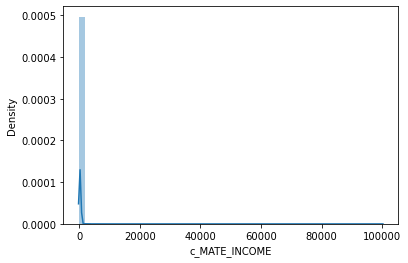

In [151]:
sns.distplot(df['c_MATE_INCOME'])

Revisamos la distribución de la edad

/home/sqpr14_/anaconda3/envs/dss/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='c_AGE', ylabel='Density'>

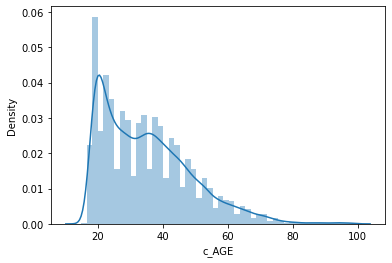

In [152]:
sns.distplot(df['c_AGE'])

In [153]:
df['c_AGE'].skew()

0.952922933038434

In [154]:
df['c_AGE'].kurt()

0.839266114257724

Tenemos bastante carga hacia la gente joven solitando crédito, ¿pero cómo se relacionan los ingresos con la edad?

In [155]:
f = px.scatter(df, x='c_AGE', y='c_PERSONAL_NET_INCOME', color='v_SEX')
f.show()

Utilizando las herramientras proporcionadas por la profesora

In [156]:
def bar(df,col,title,x_title="",y_title=""):
    layout = go.Layout(font_family="Courier New, monospace",
    font_color="black",title_text=title,title_font_size=30,xaxis= {"title": {"text": x_title,"font": {"family": 'Courier New, monospace',"size": 18,
        "color": '#002e4d'}}},yaxis= {"title": {"text": y_title,"font": {"family": 'Courier New, monospace',"size": 18,
        "color": '#002e4d'}}},title_font_family="Courier New, monospace",title_font_color="#004878",template="plotly_white")
    aux=pd.DataFrame(df[col].value_counts()).reset_index().rename(columns={"index":"conteo"})
    fig=aux.iplot(kind='bar',x="conteo",y=col,title=title,asFigure=True,barmode="overlay",sortbars=True,color="#255479",layout=layout)
    fig.update_layout(width=800)
    fig.update_traces(marker_color='#005a96')
    return fig

def pie(df,col,title,x_title="",y_title=""):
    layout = go.Layout(template="plotly_white")
    colors=[ "#152337", "#183152","#17416d","#005096","#00569c","#005ba3","#0061a9","#1567af","#226cb6","#2c72bc", "#0061a9","#4c79b7","#7492c6","#98acd4","#bbc7e2","#dde3f1","#ffffff"
]
    aux=pd.DataFrame(df[col].value_counts()).reset_index().rename(columns={"index":"conteo"})
    fig=aux.iplot(kind='pie',labels="conteo",values=col,title=title,asFigure=True,theme="white")
    
    fig.update_traces(textfont_size=10,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))
    fig.update_traces(textposition='inside', textinfo='percent+label')
    fig.update_layout(font_family="Courier New, monospace",
    font_color="black",title_text=title,title_font_size=30,title_font_family="Courier New, monospace",title_font_color="#004878",template="plotly_white")
    return fig

def box(df,col,title):
    layout = go.Layout(font_family="Courier New, monospace",
    font_color="black",title_text=title,title_font_size=30,xaxis= {"title": {"font": {"family": 'Courier New, monospace',"size": 18,
        "color": '#002e4d'}}},title_font_family="Courier New, monospace",title_font_color="#004878",template="plotly_white")
    fig=df[[col]].iplot(kind='box',title=title,asFigure=True,theme="white",layout=layout,color="#005a96", boxpoints='outliers')
    return fig

def histogram(df,col,bins,title):
    layout = go.Layout(font_family="Courier New, monospace",
    font_color="black",title_text=title,title_font_size=30,xaxis= {"title": {"font": {"family": 'Courier New, monospace',"size": 18,
        "color": '#002e4d'}}},title_font_family="Courier New, monospace",title_font_color="#004878",template="plotly_white")
    fig=df[[col]].iplot(kind='histogram',x=col,bins=bins,title=title,asFigure=True,theme="white",layout=layout,color="#003e6c")
    fig.update_traces(opacity=0.90)
    return fig

def completitud(df):
    comp=pd.DataFrame(df.isnull().sum())
    comp.reset_index(inplace=True)
    comp=comp.rename(columns={"index":"columna",0:"total"})
    comp["completitud"]=(1-comp["total"]/df.shape[0])*100
    comp=comp.sort_values(by="completitud",ascending=True)
    comp.reset_index(drop=True,inplace=True)
    return comp

Obtenemos gráficos de barras por observar la manera en la que están conformadas las variables categóricas

In [157]:
for col in df.filter(like="v_"):
    bar(df,col,col).show()

y finalmente nuestra variable objetivo

In [158]:
bar(df, 'tgt', 'target').show()

Nota: Para el caso de la única variable que se encuentra etiquetada como geográfica, nunca encontré a qué país pertencen esos códigos, por lo que no se procedió a realizar un mapa, pero sí una gráfica de la densidad de cada código, sólo por ver de dónde llegan más solicitudes

In [159]:
f = px.scatter(df, x='c_AGE', y='g_AREA_CODE_RESIDENCIAL_PHONE', color='v_SEX')
f.show()

La mayoría de solicitudes provienen de las áreas 30 y 50

In [160]:
tratamiento_1 = df.copy()
tratamiento_2 = df.copy()

# Datos anómalos

In [161]:
def OUTLIERS(df,cols):
    results=pd.DataFrame()
    data_iqr=df.copy()
    data_per=df.copy()
    total=[]
    total_per=[]
    total_z=[]
    indices_=[]

    for col in cols:
        #IQR
        Q1=df[col].quantile(0.25)
        Q3=df[col].quantile(0.75)
        IQR=Q3-Q1
        INF=Q1-1.5*(IQR)
        SUP=Q3+1.5*(IQR)
    
        
        n_outliers=df[(df[col] < INF) | (df[col] > SUP)].shape[0]
        total.append(n_outliers)
        indices_iqr=list(df[(df[col] < INF) | (df[col] > SUP)].index)
        #data_iqr=data_iqr[~(data_iqr[col] < INF) | (data_iqr[col] > SUP)].reset_index(drop=True)
        
        #Percentiles
        INF_pe=np.percentile(df[col].dropna(),5)
    
        SUP_pe=np.percentile(df[col].dropna(),95)
        n_outliers_per=df[(df[col] < INF_pe) | (df[col] > SUP_pe)].shape[0]
        total_per.append(n_outliers_per)
        indices_per=list(df[(df[col] < INF_pe) | (df[col] > SUP_pe)].index)
        #data_per=data_per[~(data_per[col] < INF_pe) | (data_per[col] > SUP_pe)].reset_index(drop=True)
        
        #MEAN CHANGE
        
        #Obtenemos todos los percentiles además del máximo
        perc_100 = [x / 100 for x in range(100)]
        dist = df[col].describe(perc_100).iloc[4:]
        #Obtenemos el cambio entre percentiles
        change_dist = df[col].describe(perc_100).iloc[4:].diff()
        #Obtenemos el cambio promedio entre percentiles
        mean_change = df[col].describe(
            perc_100).iloc[4:].diff().mean()
        #Si el cambio entre el percentil 99 y el maximo es mayor a el cambio promedio entonces:
        if change_dist["max"] > mean_change:
            #La banda superior será el máximo menos el cambio promedio
            ub = dist["max"] - mean_change
            #si la banda superior es más pequeña que el percentil 99 , modificamos la banda para que tome el percentil 99
            if ub < dist["99%"]:
                ub = dist["99%"]
        else:
        #Si el cambio entre el percentil 99 y el maximo es menor o igual a el cambio promedio entonces se toma el percentil 99
            ub = dist["max"]

        if change_dist["1%"] > mean_change:
            lb = dist["0%"] + mean_change
            if lb > dist["1%"]:
                lb = dist["1%"]
        else:
            lb = dist["0%"]
        n_total_z=df[(df[col] < lb) | (df[col] > ub)].shape[0]
        total_z.append(n_total_z)
        indices_z=list(df[(df[col] < lb) | (df[col] > ub)].index)
        
        indices_.append(aux_outliers(indices_iqr,indices_per,indices_z))
        
    results["features"]=cols
    results["n_outliers_IQR"]=total
    results["n_outliers_Percentil"]=total_per
    results["n_outliers_Mean_Change"]=total_z
    results["n_outliers_IQR_%"]=round((results["n_outliers_IQR"]/df.shape[0])*100,2)
    results["n_outliers_Percentil_%"]=round((results["n_outliers_Percentil"]/df.shape[0])*100,2)
    results["n_outliers_Mean_Change_%"]=round((results["n_outliers_Mean_Change"]/df.shape[0])*100,2)
    results["indices"]=indices_
    results["total_outliers"]=results["indices"].map(lambda x:len(x))
    results["%_outliers"]=results["indices"].map(lambda x:round(((len(x)/df.shape[0])*100),2))
    results=results[['features', 'n_outliers_IQR', 'n_outliers_Percentil',
       'n_outliers_Mean_Change', 'n_outliers_IQR_%', 'n_outliers_Percentil_%',
       'n_outliers_Mean_Change_%',  'total_outliers', '%_outliers','indices']]
    return results
def aux_outliers(a,b,c):
    a=set(a)
    b=set(b)
    c=set(c)
    
    a_=a.intersection(b)

    b_=b.intersection(c)

    c_=a.intersection(c)

    outliers_index=list(set(list(a_)+list(b_)+list(c_)))
    return outliers_index

In [162]:
for c in tratamiento_1.filter(like='c_'):
    box(tratamiento_1, c, c).show()

In [163]:
for c in tratamiento_1.filter(like='c_'):
    histogram(tratamiento_1, c, 10, c).show()

In [164]:
df['c_SHOP_RANK'].value_counts()

0    47931
3      214
2       66
Name: c_SHOP_RANK, dtype: int64

In [165]:
214/df.shape[0] + 66/df.shape[0]

0.00580780319844019

La variable c_SHOP_RANK es prácticamenbte unaria, menos del 1% de los valores son diferentes, por lo que se elimina, ya que hasta esta isntancia se descrubrió

In [166]:
df.drop('c_SHOP_RANK', axis=1, inplace=True)

In [167]:
df['c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION'].value_counts(1)

0    0.869117
1    0.113045
2    0.017755
3    0.000083
Name: c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION, dtype: float64

In [168]:
c = list(df.filter(like='c_'))
c

['c_AGE',
 'c_MONTHS_IN_RESIDENCE',
 'c_MONTHS_IN_THE_JOB',
 'c_MATE_INCOME',
 'c_QUANT_BANKING_ACCOUNTS',
 'c_PERSONAL_NET_INCOME',
 'c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION']

In [169]:
df['c_AGE'] = df['c_AGE'].astype(int)
df['c_MONTHS_IN_RESIDENCE'] = df['c_MONTHS_IN_RESIDENCE'].astype(int)
df['c_MONTHS_IN_THE_JOB'] = df['c_MONTHS_IN_THE_JOB'].astype(int)
df['c_MATE_INCOME'] = df['c_MATE_INCOME'].astype(int)
df['c_QUANT_BANKING_ACCOUNTS'] = df['c_QUANT_BANKING_ACCOUNTS'].astype(int)
df['c_PERSONAL_NET_INCOME'] = df['c_PERSONAL_NET_INCOME'].astype(int)
df['c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION'] = df['c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION'].astype(int)

In [170]:
i = OUTLIERS(tratamiento_1, ['c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION', 'c_AGE', 'c_MONTHS_IN_RESIDENCE',
                            'c_QUANT_BANKING_ACCOUNTS', 'c_MONTHS_IN_THE_JOB'])

In [171]:
i

,features,n_outliers_IQR,n_outliers_Percentil,n_outliers_Mean_Change,n_outliers_IQR_%,n_outliers_Percentil_%,n_outliers_Mean_Change_%,total_outliers,%_outliers,indices
0,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,6310,860,4,13.09,1.78,0.01,860,1.78,"[38913, 12290, 28676, 20487, 2057, 4106, 18447..."
1,c_AGE,418,4008,16,0.87,8.31,0.03,423,0.88,"[43015, 36926, 16449, 38981, 45132, 16466, 472..."
2,c_MONTHS_IN_RESIDENCE,566,3158,1,1.17,6.55,0.00,566,1.17,"[38915, 43015, 4107, 30737, 12311, 6188, 20527..."
3,c_QUANT_BANKING_ACCOUNTS,0,0,0,0.00,0.00,0.00,0,0.00,[]
4,c_MONTHS_IN_THE_JOB,5265,2239,1,10.92,4.64,0.00,2239,4.64,"[32773, 40965, 40972, 8211, 8212, 32787, 24598..."


In [172]:
i = list(i['indices'].values)

In [173]:
from  functools import reduce
i=list(set(reduce(lambda x,y: x+y, i)))

In [174]:
len(i)

3797

In [175]:
len(i)/tratamiento_1.shape[0]

0.07875795980170501

In [176]:
i

[32773,
 40965,
 40972,
 8211,
 8212,
 32787,
 24598,
 16407,
 24600,
 32794,
 24603,
 40992,
 34,
 24611,
 24621,
 24625,
 32818,
 16437,
 8246,
 24632,
 16449,
 16451,
 67,
 8261,
 16454,
 24646,
 72,
 24649,
 24650,
 16461,
 16464,
 16466,
 24660,
 8278,
 16470,
 32854,
 8281,
 8279,
 32859,
 32861,
 8287,
 32863,
 97,
 24674,
 41060,
 102,
 106,
 32876,
 8302,
 24687,
 41073,
 24690,
 41075,
 32884,
 24696,
 16505,
 24699,
 41085,
 8320,
 32896,
 24706,
 134,
 24710,
 24716,
 8339,
 41107,
 16542,
 41122,
 165,
 16557,
 41135,
 8373,
 8377,
 188,
 32959,
 32960,
 193,
 8385,
 8387,
 16578,
 24771,
 8390,
 41157,
 24778,
 16593,
 211,
 212,
 8405,
 16595,
 215,
 8408,
 24793,
 224,
 8419,
 24803,
 229,
 231,
 33001,
 24810,
 41193,
 8427,
 41197,
 24814,
 41199,
 240,
 41200,
 24819,
 33012,
 33014,
 41212,
 41214,
 33022,
 16644,
 33036,
 271,
 41231,
 16662,
 16663,
 281,
 24861,
 16673,
 33062,
 296,
 33065,
 41258,
 24878,
 8496,
 8497,
 8501,
 24886,
 41272,
 312,
 16697,
 1670

El 7% de los datos son dato anómalos, se pueden quitar sin problema

In [177]:
df.drop(df.loc[i].index, inplace=True)

In [178]:
df.shape

(44414, 21)

In [179]:
for c in tratamiento_1.filter(like='c_'):
    histogram(tratamiento_1, c, 10, c).show()

# Datos faltantes (missings)

Para este caso los se hizo el tratamiento apra datos faltantes desdde elp proceso de calidad de datos, por lo que se moite este paso

# Ingeneiría de variables

In [180]:
tratamiento_1.head()

,v_ID_SHOP,v_SEX,v_MARITAL_STATUS,c_AGE,v_FLAG_RESIDENCIAL_PHONE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,v_RESIDENCE_TYPE,c_MONTHS_IN_RESIDENCE,v_FLAG_MOTHERS_NAME,v_FLAG_FATHERS_NAME,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,v_FLAG_RESIDENCE_STATE=WORKING_STATE,c_MONTHS_IN_THE_JOB,t_PROFESSION,c_MATE_INCOME,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,tgt
0,15,0,S,18,y,31,20,0,p,216,Y,Y,Y,Y,12,Educational Instruction and Library,0,Y,0,300,0,0
1,16,0,S,28,y,31,25,0,x,12,Y,Y,Y,Y,12,Healthcare Practitioners and Technical,0,Y,0,200,0,0
2,24,1,S,26,n,31,28,0,p,180,Y,Y,N,Y,0,Healthcare Practitioners and Technical,0,Y,0,800,0,0
3,55,0,S,22,y,31,12,0,a,0,Y,Y,Y,Y,48,Healthcare Practitioners and Technical,0,Y,0,400,0,0
4,6,0,C,21,y,23,28,0,a,24,Y,Y,Y,Y,12,Healthcare Practitioners and Technical,800,Y,0,200,0,0


In [181]:
columns=list(tratamiento_1.filter(like='v_'))
columns

['v_ID_SHOP',
 'v_SEX',
 'v_MARITAL_STATUS',
 'v_FLAG_RESIDENCIAL_PHONE',
 'v_RESIDENCE_TYPE',
 'v_FLAG_MOTHERS_NAME',
 'v_FLAG_FATHERS_NAME',
 'v_FLAG_RESIDENCE_TOWN=WORKING_TOWN',
 'v_FLAG_RESIDENCE_STATE=WORKING_STATE',
 'v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS']

In [182]:
columns.pop(1)

'v_SEX'

In [183]:
columns

['v_ID_SHOP',
 'v_MARITAL_STATUS',
 'v_FLAG_RESIDENCIAL_PHONE',
 'v_RESIDENCE_TYPE',
 'v_FLAG_MOTHERS_NAME',
 'v_FLAG_FATHERS_NAME',
 'v_FLAG_RESIDENCE_TOWN=WORKING_TOWN',
 'v_FLAG_RESIDENCE_STATE=WORKING_STATE',
 'v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS']

In [184]:
tratamiento_1=pd.get_dummies(tratamiento_1, columns=columns, prefix_sep='_', drop_first=True  )

In [185]:
tratamiento_1.head()

,v_SEX,c_AGE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,c_MONTHS_IN_RESIDENCE,c_MONTHS_IN_THE_JOB,t_PROFESSION,c_MATE_INCOME,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,tgt,v_ID_SHOP_2,v_ID_SHOP_3,v_ID_SHOP_4,v_ID_SHOP_5,v_ID_SHOP_6,v_ID_SHOP_7,v_ID_SHOP_8,v_ID_SHOP_9,v_ID_SHOP_10,v_ID_SHOP_11,v_ID_SHOP_12,v_ID_SHOP_13,v_ID_SHOP_14,v_ID_SHOP_15,v_ID_SHOP_16,v_ID_SHOP_17,v_ID_SHOP_18,v_ID_SHOP_19,v_ID_SHOP_20,v_ID_SHOP_21,v_ID_SHOP_22,v_ID_SHOP_23,v_ID_SHOP_24,v_ID_SHOP_25,v_ID_SHOP_50,v_ID_SHOP_55,v_ID_SHOP_66,v_ID_SHOP_77,v_ID_SHOP_81,v_ID_SHOP_96,v_MARITAL_STATUS_D,v_MARITAL_STATUS_O,v_MARITAL_STATUS_S,v_MARITAL_STATUS_V,v_FLAG_RESIDENCIAL_PHONE_y,v_RESIDENCE_TYPE_c,v_RESIDENCE_TYPE_o,v_RESIDENCE_TYPE_p,v_RESIDENCE_TYPE_x,v_FLAG_MOTHERS_NAME_Y,v_FLAG_FATHERS_NAME_Y,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN_Y,v_FLAG_RESIDENCE_STATE=WORKING_STATE_Y,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS_Y
0,0,18,31,20,0,216,12,Educational Instruction and Library,0,0,300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,1,1,1,1,1
1,0,28,31,25,0,12,12,Healthcare Practitioners and Technical,0,0,200,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,1,1,1,1,1
2,1,26,31,28,0,180,0,Healthcare Practitioners and Technical,0,0,800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,1,0,1,1
3,0,22,31,12,0,0,48,Healthcare Practitioners and Technical,0,0,400,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,1,1,1,1,1
4,0,21,23,28,0,24,12,Healthcare Practitioners and Technical,800,0,200,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,1,1,1


Se crean todas las variables con sufijo '_X'

### Trtatamiento de variables de texto

Sólo tenemos una variable de texto que es la que corresponde con la profesión

In [186]:
def clean_text(text, pattern="[^a-zA-Z0-9 ]"):
    cleaned_text = unicodedata.normalize('NFD', text).encode('ascii', 'ignore')
    cleaned_text = re.sub(pattern, " ", cleaned_text.decode("utf-8"), flags=re.UNICODE)
    cleaned_text = u' '.join(cleaned_text.lower().strip().split())
    return cleaned_text

In [187]:
tratamiento_1['t_PROFESSION'] = tratamiento_1['t_PROFESSION'].astype(str)

In [188]:
tratamiento_1['t_PROFESSION']=tratamiento_1['t_PROFESSION'].map(lambda x:clean_text(x, pattern="[^a-zA-Z ]"))

In [189]:
tratamiento_1['t_PROFESSION']

0           educational instruction and library
1        healthcare practitioners and technical
2        healthcare practitioners and technical
3        healthcare practitioners and technical
4        healthcare practitioners and technical
                          ...                  
48206    healthcare practitioners and technical
48207       educational instruction and library
48208    healthcare practitioners and technical
48209       educational instruction and library
48210       educational instruction and library
Name: t_PROFESSION, Length: 48211, dtype: object

In [190]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/sqpr14_/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [191]:
stop_words=nltk.corpus.stopwords.words("english")

In [192]:
tratamiento_1["t_PROFESSION"]=tratamiento_1["t_PROFESSION"].map(lambda text:" ".join([x for x in text.split(" ") if x not in stop_words]))

In [193]:
corpus=" ".join(tratamiento_1["t_PROFESSION"].values)

In [194]:
corpus

'educational instruction library healthcare practitioners technical healthcare practitioners technical healthcare practitioners technical healthcare practitioners technical healthcare practitioners technical educational instruction library life physical social science life physical social science healthcare practitioners technical educational instruction library life physical social science production healthcare practitioners technical healthcare practitioners technical healthcare practitioners technical production life physical social science educational instruction library educational instruction library educational instruction library healthcare practitioners technical healthcare practitioners technical life physical social science educational instruction library production educational instruction library healthcare practitioners technical educational instruction library educational instruction library healthcare practitioners technical healthcare practitioners technical production 

In [195]:
corpus.split()

['educational',
 'instruction',
 'library',
 'healthcare',
 'practitioners',
 'technical',
 'healthcare',
 'practitioners',
 'technical',
 'healthcare',
 'practitioners',
 'technical',
 'healthcare',
 'practitioners',
 'technical',
 'healthcare',
 'practitioners',
 'technical',
 'educational',
 'instruction',
 'library',
 'life',
 'physical',
 'social',
 'science',
 'life',
 'physical',
 'social',
 'science',
 'healthcare',
 'practitioners',
 'technical',
 'educational',
 'instruction',
 'library',
 'life',
 'physical',
 'social',
 'science',
 'production',
 'healthcare',
 'practitioners',
 'technical',
 'healthcare',
 'practitioners',
 'technical',
 'healthcare',
 'practitioners',
 'technical',
 'production',
 'life',
 'physical',
 'social',
 'science',
 'educational',
 'instruction',
 'library',
 'educational',
 'instruction',
 'library',
 'educational',
 'instruction',
 'library',
 'healthcare',
 'practitioners',
 'technical',
 'healthcare',
 'practitioners',
 'technical',
 'life',


In [196]:
fdist=nltk.FreqDist(corpus.split())

In [197]:
fdist

FreqDist({'healthcare': 19413, 'practitioners': 19413, 'technical': 19413, 'educational': 12393, 'instruction': 12393, 'library': 12393, 'production': 8899, 'life': 7506, 'physical': 7506, 'social': 7506, ...})

In [198]:
pd.DataFrame(fdist.items()).sort_values(by=[1])

,0,1
6,life,7506
7,physical,7506
8,social,7506
9,science,7506
10,production,8899
0,educational,12393
1,instruction,12393
2,library,12393
3,healthcare,19413
4,practitioners,19413


In [199]:
list_hapaxes=fdist.hapaxes()

In [200]:
list_hapaxes

[]

In [201]:
tratamiento_1["t_PROFESSION"]=tratamiento_1["t_PROFESSION"].map(lambda text:" ".join([x for x in text.split(" ") if x not in list_hapaxes]))

In [202]:
tratamiento_1.head()

,v_SEX,c_AGE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,c_MONTHS_IN_RESIDENCE,c_MONTHS_IN_THE_JOB,t_PROFESSION,c_MATE_INCOME,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,tgt,v_ID_SHOP_2,v_ID_SHOP_3,v_ID_SHOP_4,v_ID_SHOP_5,v_ID_SHOP_6,v_ID_SHOP_7,v_ID_SHOP_8,v_ID_SHOP_9,v_ID_SHOP_10,v_ID_SHOP_11,v_ID_SHOP_12,v_ID_SHOP_13,v_ID_SHOP_14,v_ID_SHOP_15,v_ID_SHOP_16,v_ID_SHOP_17,v_ID_SHOP_18,v_ID_SHOP_19,v_ID_SHOP_20,v_ID_SHOP_21,v_ID_SHOP_22,v_ID_SHOP_23,v_ID_SHOP_24,v_ID_SHOP_25,v_ID_SHOP_50,v_ID_SHOP_55,v_ID_SHOP_66,v_ID_SHOP_77,v_ID_SHOP_81,v_ID_SHOP_96,v_MARITAL_STATUS_D,v_MARITAL_STATUS_O,v_MARITAL_STATUS_S,v_MARITAL_STATUS_V,v_FLAG_RESIDENCIAL_PHONE_y,v_RESIDENCE_TYPE_c,v_RESIDENCE_TYPE_o,v_RESIDENCE_TYPE_p,v_RESIDENCE_TYPE_x,v_FLAG_MOTHERS_NAME_Y,v_FLAG_FATHERS_NAME_Y,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN_Y,v_FLAG_RESIDENCE_STATE=WORKING_STATE_Y,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS_Y
0,0,18,31,20,0,216,12,educational instruction library,0,0,300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,1,1,1,1,1
1,0,28,31,25,0,12,12,healthcare practitioners technical,0,0,200,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,1,1,1,1,1
2,1,26,31,28,0,180,0,healthcare practitioners technical,0,0,800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,1,0,1,1
3,0,22,31,12,0,0,48,healthcare practitioners technical,0,0,400,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,1,1,1,1,1
4,0,21,23,28,0,24,12,healthcare practitioners technical,800,0,200,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,1,1,1


In [203]:
tratamiento_1["t_PROFESSION"]=tratamiento_1["t_PROFESSION"].map(lambda x:x.split())

In [204]:
tratamiento_1.head()


,v_SEX,c_AGE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,c_MONTHS_IN_RESIDENCE,c_MONTHS_IN_THE_JOB,t_PROFESSION,c_MATE_INCOME,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,tgt,v_ID_SHOP_2,v_ID_SHOP_3,v_ID_SHOP_4,v_ID_SHOP_5,v_ID_SHOP_6,v_ID_SHOP_7,v_ID_SHOP_8,v_ID_SHOP_9,v_ID_SHOP_10,v_ID_SHOP_11,v_ID_SHOP_12,v_ID_SHOP_13,v_ID_SHOP_14,v_ID_SHOP_15,v_ID_SHOP_16,v_ID_SHOP_17,v_ID_SHOP_18,v_ID_SHOP_19,v_ID_SHOP_20,v_ID_SHOP_21,v_ID_SHOP_22,v_ID_SHOP_23,v_ID_SHOP_24,v_ID_SHOP_25,v_ID_SHOP_50,v_ID_SHOP_55,v_ID_SHOP_66,v_ID_SHOP_77,v_ID_SHOP_81,v_ID_SHOP_96,v_MARITAL_STATUS_D,v_MARITAL_STATUS_O,v_MARITAL_STATUS_S,v_MARITAL_STATUS_V,v_FLAG_RESIDENCIAL_PHONE_y,v_RESIDENCE_TYPE_c,v_RESIDENCE_TYPE_o,v_RESIDENCE_TYPE_p,v_RESIDENCE_TYPE_x,v_FLAG_MOTHERS_NAME_Y,v_FLAG_FATHERS_NAME_Y,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN_Y,v_FLAG_RESIDENCE_STATE=WORKING_STATE_Y,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS_Y
0,0,18,31,20,0,216,12,"[educational, instruction, library]",0,0,300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,1,1,1,1,1
1,0,28,31,25,0,12,12,"[healthcare, practitioners, technical]",0,0,200,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,1,1,1,1,1
2,1,26,31,28,0,180,0,"[healthcare, practitioners, technical]",0,0,800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,1,0,1,1
3,0,22,31,12,0,0,48,"[healthcare, practitioners, technical]",0,0,400,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,1,1,1,1,1
4,0,21,23,28,0,24,12,"[healthcare, practitioners, technical]",800,0,200,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,1,1,1


In [205]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [206]:
tratamiento_1.rename(columns={'t_PROFESSION':'t_profession'}, inplace=True)

In [207]:
tratamiento_1.head()

,v_SEX,c_AGE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,c_MONTHS_IN_RESIDENCE,c_MONTHS_IN_THE_JOB,t_profession,c_MATE_INCOME,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,tgt,v_ID_SHOP_2,v_ID_SHOP_3,v_ID_SHOP_4,v_ID_SHOP_5,v_ID_SHOP_6,v_ID_SHOP_7,v_ID_SHOP_8,v_ID_SHOP_9,v_ID_SHOP_10,v_ID_SHOP_11,v_ID_SHOP_12,v_ID_SHOP_13,v_ID_SHOP_14,v_ID_SHOP_15,v_ID_SHOP_16,v_ID_SHOP_17,v_ID_SHOP_18,v_ID_SHOP_19,v_ID_SHOP_20,v_ID_SHOP_21,v_ID_SHOP_22,v_ID_SHOP_23,v_ID_SHOP_24,v_ID_SHOP_25,v_ID_SHOP_50,v_ID_SHOP_55,v_ID_SHOP_66,v_ID_SHOP_77,v_ID_SHOP_81,v_ID_SHOP_96,v_MARITAL_STATUS_D,v_MARITAL_STATUS_O,v_MARITAL_STATUS_S,v_MARITAL_STATUS_V,v_FLAG_RESIDENCIAL_PHONE_y,v_RESIDENCE_TYPE_c,v_RESIDENCE_TYPE_o,v_RESIDENCE_TYPE_p,v_RESIDENCE_TYPE_x,v_FLAG_MOTHERS_NAME_Y,v_FLAG_FATHERS_NAME_Y,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN_Y,v_FLAG_RESIDENCE_STATE=WORKING_STATE_Y,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS_Y
0,0,18,31,20,0,216,12,"[educational, instruction, library]",0,0,300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,1,1,1,1,1
1,0,28,31,25,0,12,12,"[healthcare, practitioners, technical]",0,0,200,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,1,1,1,1,1
2,1,26,31,28,0,180,0,"[healthcare, practitioners, technical]",0,0,800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,1,0,1,1
3,0,22,31,12,0,0,48,"[healthcare, practitioners, technical]",0,0,400,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,1,1,1,1,1
4,0,21,23,28,0,24,12,"[healthcare, practitioners, technical]",800,0,200,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,1,1,1


In [208]:
tratamiento_1["t_profession"]=tratamiento_1["t_profession"].map(lambda x:" ".join(x))

In [209]:
vect = TfidfVectorizer()
vect.fit(tratamiento_1["t_profession"])
array_train= vect.transform(tratamiento_1["t_profession"])

In [210]:
tratamiento_1.head()

,v_SEX,c_AGE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,c_MONTHS_IN_RESIDENCE,c_MONTHS_IN_THE_JOB,t_profession,c_MATE_INCOME,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,tgt,v_ID_SHOP_2,v_ID_SHOP_3,v_ID_SHOP_4,v_ID_SHOP_5,v_ID_SHOP_6,v_ID_SHOP_7,v_ID_SHOP_8,v_ID_SHOP_9,v_ID_SHOP_10,v_ID_SHOP_11,v_ID_SHOP_12,v_ID_SHOP_13,v_ID_SHOP_14,v_ID_SHOP_15,v_ID_SHOP_16,v_ID_SHOP_17,v_ID_SHOP_18,v_ID_SHOP_19,v_ID_SHOP_20,v_ID_SHOP_21,v_ID_SHOP_22,v_ID_SHOP_23,v_ID_SHOP_24,v_ID_SHOP_25,v_ID_SHOP_50,v_ID_SHOP_55,v_ID_SHOP_66,v_ID_SHOP_77,v_ID_SHOP_81,v_ID_SHOP_96,v_MARITAL_STATUS_D,v_MARITAL_STATUS_O,v_MARITAL_STATUS_S,v_MARITAL_STATUS_V,v_FLAG_RESIDENCIAL_PHONE_y,v_RESIDENCE_TYPE_c,v_RESIDENCE_TYPE_o,v_RESIDENCE_TYPE_p,v_RESIDENCE_TYPE_x,v_FLAG_MOTHERS_NAME_Y,v_FLAG_FATHERS_NAME_Y,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN_Y,v_FLAG_RESIDENCE_STATE=WORKING_STATE_Y,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS_Y
0,0,18,31,20,0,216,12,educational instruction library,0,0,300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,1,1,1,1,1
1,0,28,31,25,0,12,12,healthcare practitioners technical,0,0,200,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,1,1,1,1,1
2,1,26,31,28,0,180,0,healthcare practitioners technical,0,0,800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,1,0,1,1
3,0,22,31,12,0,0,48,healthcare practitioners technical,0,0,400,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,1,1,1,1,1
4,0,21,23,28,0,24,12,healthcare practitioners technical,800,0,200,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,1,1,1


In [211]:
aux_t1=pd.DataFrame(array_train.toarray(),columns=vect.get_feature_names())

In [212]:
aux_t1

,educational,healthcare,instruction,library,life,physical,practitioners,production,science,social,technical
0,0.57735,0.00000,0.57735,0.57735,0.0,0.0,0.00000,0.0,0.0,0.0,0.00000
1,0.00000,0.57735,0.00000,0.00000,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
2,0.00000,0.57735,0.00000,0.00000,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
3,0.00000,0.57735,0.00000,0.00000,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
4,0.00000,0.57735,0.00000,0.00000,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
...,...,...,...,...,...,...,...,...,...,...,...
48206,0.00000,0.57735,0.00000,0.00000,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
48207,0.57735,0.00000,0.57735,0.57735,0.0,0.0,0.00000,0.0,0.0,0.0,0.00000
48208,0.00000,0.57735,0.00000,0.00000,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
48209,0.57735,0.00000,0.57735,0.57735,0.0,0.0,0.00000,0.0,0.0,0.0,0.00000


In [213]:
tratamiento_1=pd.concat([tratamiento_1.reset_index(drop=True),aux_t1.reset_index(drop=True)],axis=1)

In [214]:
tratamiento_1

,v_SEX,c_AGE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,c_MONTHS_IN_RESIDENCE,c_MONTHS_IN_THE_JOB,t_profession,c_MATE_INCOME,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,tgt,v_ID_SHOP_2,v_ID_SHOP_3,v_ID_SHOP_4,v_ID_SHOP_5,v_ID_SHOP_6,v_ID_SHOP_7,v_ID_SHOP_8,v_ID_SHOP_9,v_ID_SHOP_10,v_ID_SHOP_11,v_ID_SHOP_12,v_ID_SHOP_13,v_ID_SHOP_14,v_ID_SHOP_15,v_ID_SHOP_16,v_ID_SHOP_17,v_ID_SHOP_18,v_ID_SHOP_19,v_ID_SHOP_20,v_ID_SHOP_21,v_ID_SHOP_22,v_ID_SHOP_23,v_ID_SHOP_24,v_ID_SHOP_25,v_ID_SHOP_50,v_ID_SHOP_55,v_ID_SHOP_66,v_ID_SHOP_77,v_ID_SHOP_81,v_ID_SHOP_96,v_MARITAL_STATUS_D,v_MARITAL_STATUS_O,v_MARITAL_STATUS_S,v_MARITAL_STATUS_V,v_FLAG_RESIDENCIAL_PHONE_y,v_RESIDENCE_TYPE_c,v_RESIDENCE_TYPE_o,v_RESIDENCE_TYPE_p,v_RESIDENCE_TYPE_x,v_FLAG_MOTHERS_NAME_Y,v_FLAG_FATHERS_NAME_Y,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN_Y,v_FLAG_RESIDENCE_STATE=WORKING_STATE_Y,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS_Y,educational,healthcare,instruction,library,life,physical,practitioners,production,science,social,technical
0,0,18,31,20,0,216,12,educational instruction library,0,0,300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,1,1,1,1,1,0.57735,0.00000,0.57735,0.57735,0.0,0.0,0.00000,0.0,0.0,0.0,0.00000
1,0,28,31,25,0,12,12,healthcare practitioners technical,0,0,200,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,1,1,1,1,1,0.00000,0.57735,0.00000,0.00000,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
2,1,26,31,28,0,180,0,healthcare practitioners technical,0,0,800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,1,0,1,1,0.00000,0.57735,0.00000,0.00000,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
3,0,22,31,12,0,0,48,healthcare practitioners technical,0,0,400,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,1,1,1,1,1,0.00000,0.57735,0.00000,0.00000,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
4,0,21,23,28,0,24,12,healthcare practitioners technical,800,0,200,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,1,1,1,0.00000,0.57735,0.00000,0.00000,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48206,0,72,31,23,0,120,12,healthcare practitioners technical,0,0,400,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,1,1,1,1,1,0.00000,0.57735,0.00000,0.00000,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
48207,0,31,31,18,0,240,72,educational instruction library,0,0,900,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,1,1,0,1,1,0.57735,0.00000,0.57735,0.57735,0.0,0.0,0.00000,0.0,0.0,0.0,0.00000
48208,0,51,31,20,0,12,24,healthcare practitioners technical,0,0,200,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,1,0,1,1,0.00000,0.57735,0.00000,0.00000,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
48209,0,71,50,12,0,300,0,educational instruction library,0,0,1000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,1,1,1,1,0.57735,0.00000,0.57735,0.57735,0.0,0.0,0.00000,0.0,0.0,0.0,0.00000


In [215]:
del(aux_t1)

Se crearon las variables educational, healthcare, intrucrtion, library life physical practitioners production  sicence social technical

# Selección de variables

In [216]:
from sklearn.model_selection import train_test_split

In [217]:
def chi_square(df,col,valor_miss):
    x_i=df[col].fillna(valor_miss).value_counts()
    k=x_i.sum()
    p_i=df[col].dropna().value_counts(1)
    m_i=k*p_i
    chi=chisquare(f_obs=x_i,f_exp=m_i)
    p_val=chi.pvalue
    alpha=0.05
    if p_val<alpha:
        print("Rechazamos HO(La porporción de categorias es la misma que la general)")
    else:
        print("Aceptamos HO(La porporción de categorias es la misma que la general)")
        
def other(df,col,n):
    aux=list(df[col].value_counts(1).index[n:].values)
    dictio_aux=dict(zip(aux,["otro"]*len(aux)))
    df[col]=df[col].replace(dictio_aux)
    return df

def multiple_replace(string, rep_dict):
    pattern = re.compile("|".join([re.escape(k) for k in sorted(rep_dict,key=len,reverse=True)]), flags=re.DOTALL)
    return pattern.sub(lambda x: rep_dict[x.group(0)]+"_", string)

def multicolinealidad_cate(df,y,threshold=5,only_final_vif=True):
    '''
    Función para calcular el VIF Genralizado, (GVIF, Fox and Monette 1992)
    Las variables no deben de deben de estar transformadas con OneHotEncoder ya que la función lo realiza internamnete.
    Args:
        df
        y
        threshold
        only_final_vif
    
    Returns:
        pandas data frame: a data frame, indexed by factor of the GVIF, GVIF^(1/2Df), VIF^(1/2Df)^2 
        dictionary: Dictionary of column names (keys) and GVIF ** (1 / (2 * Df)) ** 2 (values)
    '''

    df_x = df.drop(y,axis=1)
    #Guardamos los nombres de las columnas añadiendo el prefijo

    onehot_list = list(df_x.select_dtypes(include=['category', 'object', 'string']).columns)
    #Generamos las variables dummy 
    
    df_1hot = pd.get_dummies(df_x, drop_first=True, dummy_na=False, prefix_sep='_')


    #Dataframe vacio para guardar los resultados
    gvif_df = pd.DataFrame(columns = ['factor','GVIF','Df','GVIF^(1/2Df)', 'VIF'])

    # Iteramos sobre las columas
    for (columnName, columnData) in df_x.iteritems():
        #Si se generaron las de una columna, es decir la variable tiene más de dos posibilidades utilizamos todas las variables creadas
        
        if columnName in onehot_list:
            X1 = df_1hot.loc[:, df_1hot.columns.str.startswith(columnName)]
            X2 = df_1hot.loc[:, ~df_1hot.columns.str.startswith(columnName)]
        else:
            X1 = df_1hot[[columnName]].values
            X2 = df_1hot.loc[:, df_1hot.columns != columnName].values
        display(X1)
        # Calculamose gvif
        #A la matriz de correlación de las variables codificadas en caliente del atributo en consideración.
        #B la matriz de correlación de todos los demás atributos del conjunto de datos (uno codificado en dummy y numérico) excluyendo los de A.
        #C la matriz de correlación de las variables consideradas tanto en A como en B.
        #GVIF= (det(A)*det(B))/det(C)
        display(np.corrcoef(X1, rowvar=False))
        gvif = np.linalg.det(np.array(np.corrcoef(X1, rowvar=False), ndmin=2)) * np.linalg.det(np.corrcoef(X2, rowvar=False)) / np.linalg.det(np.corrcoef(np.append(X1, X2, axis=1), rowvar=False))
        #(GVIF) elevado a (1 / (2 * grados de libertad))
        #Los grados de libertad es 1-n (n=Número de opciones que tiene la variable categorica)
        gvif_12df = np.power(gvif, 1 / (2 * X1.shape[1]))
        gvif_12df_sq = gvif_12df ** 2
        DF =  X1.shape[1]
    

        # 
        new_row = {'factor': columnName, 'GVIF': gvif,'Df':DF, 'GVIF^(1/2Df)': gvif_12df, 'VIF': gvif_12df_sq}
        gvif_df = gvif_df.append(new_row, ignore_index=True)

    gvif_df = gvif_df.set_index('factor')
    if only_final_vif:
        gvif_df_final = gvif_df.drop(['GVIF','Df','GVIF^(1/2Df)'],axis=1)
    else:
        gvif_df_final = gvif_df 
    gvif_filter = gvif_df.loc[gvif_df['VIF'] >= threshold]['VIF'].to_dict()
    if gvif_filter:
        for i in gvif_filter.keys():
            df_x_m = df_x.drop([i],axis=1)
    else:
        df_x_m = df_x
    df_m=pd.concat([df_x_m,df[y]],axis=1)
    return gvif_df_final,gvif_filter,df_m


In [218]:
X_train,X_test=train_test_split(tratamiento_1,test_size=.2,random_state=14)

In [219]:
X_train.filter(like="c_").describe(percentiles=np.arange(0.1,1.1,.1))

,c_AGE,c_SHOP_RANK,c_MONTHS_IN_RESIDENCE,c_MONTHS_IN_THE_JOB,c_QUANT_BANKING_ACCOUNTS,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION
count,38568.000000,38568.000000,38568.000000,38568.000000,38568.0,38568.000000
mean,35.218523,0.015661,153.383945,50.789670,0.0,0.151239
std,13.838309,0.210477,136.008869,74.114002,0.0,0.406944
min,15.000000,0.000000,0.000000,0.000000,0.0,0.000000
10%,20.000000,0.000000,12.000000,0.000000,0.0,0.000000
20%,22.000000,0.000000,24.000000,0.000000,0.0,0.000000
30%,25.000000,0.000000,48.000000,12.000000,0.0,0.000000
40%,29.000000,0.000000,72.000000,12.000000,0.0,0.000000
50%,33.000000,0.000000,120.000000,24.000000,0.0,0.000000
60%,37.000000,0.000000,168.000000,36.000000,0.0,0.000000


In [220]:
X_train.drop(['c_SHOP_RANK', 'c_QUANT_BANKING_ACCOUNTS', 'c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION'], axis=1, inplace=True)
X_test.drop(['c_SHOP_RANK', 'c_QUANT_BANKING_ACCOUNTS', 'c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION'], axis=1, inplace=True)

In [221]:
X_train[[x for x in X_train if x!="tgt_SalePrice"]].filter(like="c_").corr(method="spearman").iplot(kind="heatmap",colorscale="orrd",title="Matriz de Correlación")

In [222]:
corr=X_train[[x for x in X_train if x!="tgt"]].filter(like="c_").corr(method="spearman")

In [223]:
X_train.filter(like="v_").columns

Index(['v_SEX', 'v_ID_SHOP_2', 'v_ID_SHOP_3', 'v_ID_SHOP_4', 'v_ID_SHOP_5',
       'v_ID_SHOP_6', 'v_ID_SHOP_7', 'v_ID_SHOP_8', 'v_ID_SHOP_9',
       'v_ID_SHOP_10', 'v_ID_SHOP_11', 'v_ID_SHOP_12', 'v_ID_SHOP_13',
       'v_ID_SHOP_14', 'v_ID_SHOP_15', 'v_ID_SHOP_16', 'v_ID_SHOP_17',
       'v_ID_SHOP_18', 'v_ID_SHOP_19', 'v_ID_SHOP_20', 'v_ID_SHOP_21',
       'v_ID_SHOP_22', 'v_ID_SHOP_23', 'v_ID_SHOP_24', 'v_ID_SHOP_25',
       'v_ID_SHOP_50', 'v_ID_SHOP_55', 'v_ID_SHOP_66', 'v_ID_SHOP_77',
       'v_ID_SHOP_81', 'v_ID_SHOP_96', 'v_MARITAL_STATUS_D',
       'v_MARITAL_STATUS_O', 'v_MARITAL_STATUS_S', 'v_MARITAL_STATUS_V',
       'v_FLAG_RESIDENCIAL_PHONE_y', 'v_RESIDENCE_TYPE_c',
       'v_RESIDENCE_TYPE_o', 'v_RESIDENCE_TYPE_p', 'v_RESIDENCE_TYPE_x',
       'v_FLAG_MOTHERS_NAME_Y', 'v_FLAG_FATHERS_NAME_Y',
       'v_FLAG_RESIDENCE_TOWN=WORKING_TOWN_Y',
       'v_FLAG_RESIDENCE_STATE=WORKING_STATE_Y',
       'v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS_Y'],
      dtype='object')

In [224]:
corr=abs(corr)

In [225]:
for col in corr.columns:
    display(corr[[col]][corr[[col]]>.8].dropna())

,c_AGE
c_AGE,1.0


,c_MONTHS_IN_RESIDENCE
c_MONTHS_IN_RESIDENCE,1.0


,c_MONTHS_IN_THE_JOB
c_MONTHS_IN_THE_JOB,1.0


In [226]:
feats=list(X_train.filter(like="c_").columns)+["tgt"]

In [227]:
X_train[feats].corr(method="spearman").iplot(kind="heatmap",colorscale="orrd",title="Matriz de Correlación")

In [228]:
corr=X_train[feats].corr(method="spearman")
corr=abs(corr)
corr[["tgt"]].sort_values(by = 'tgt',ascending = False).style.background_gradient()

,tgt
tgt,1.000000
c_AGE,0.116426
c_MONTHS_IN_THE_JOB,0.073517
c_MONTHS_IN_RESIDENCE,0.025423


In [229]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [230]:
#Función para multicolineaidad con continuas
def calc_vif(X):
    vif = pd.DataFrame()
    vif["variables"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
    return(vif)

In [231]:
for col in X_train.filter(like="c_").columns:
    X_train[col]=X_train[col].astype(float)

In [232]:
vif=calc_vif(X_train[[x for x in X_train.filter(like="c_") if x not in [ "tgt"]]])

In [233]:
vif

,variables,VIF
0,c_AGE,2.940397
1,c_MONTHS_IN_RESIDENCE,2.309733
2,c_MONTHS_IN_THE_JOB,1.644876
3,c_MATE_INCOME,1.006867
4,c_PERSONAL_NET_INCOME,1.000241


In [234]:
vif[vif["VIF"]>10].sort_values(by=["variables","VIF"],ascending=False).head(50)

,variables,VIF


In [235]:
v_feats=list(X_train.filter(like="v_").columns)

In [236]:
results=multicolinealidad_cate(df=X_train[v_feats+["tgt"]],y="tgt")

array([[0],
       [1],
       [1],
       ...,
       [0],
       [0],
       [0]])

1.0

array([[0],
       [1],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [1],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[1],
       [0],
       [1],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [1],
       [0],
       [1]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[1],
       [1],
       [1],
       ...,
       [1],
       [1],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[1],
       [1],
       [1],
       ...,
       [1],
       [1],
       [1]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [1],
       [0]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[1],
       [1],
       [1],
       ...,
       [1],
       [0],
       [1]], dtype=uint8)

1.0

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

1.0

array([[1],
       [1],
       [1],
       ...,
       [1],
       [1],
       [1]], dtype=uint8)

1.0

array([[1],
       [1],
       [1],
       ...,
       [1],
       [1],
       [1]], dtype=uint8)

1.0

array([[1],
       [1],
       [1],
       ...,
       [1],
       [0],
       [1]], dtype=uint8)

1.0

array([[1],
       [1],
       [1],
       ...,
       [1],
       [1],
       [1]], dtype=uint8)

1.0

array([[1],
       [1],
       [1],
       ...,
       [1],
       [1],
       [1]], dtype=uint8)

1.0

In [237]:
X_train.filter(like="c_")

,c_AGE,c_MONTHS_IN_RESIDENCE,c_MONTHS_IN_THE_JOB,c_MATE_INCOME,c_PERSONAL_NET_INCOME
30193,51.0,12.0,12.0,0.0,700.0
14903,21.0,108.0,0.0,0.0,200.0
13789,19.0,120.0,24.0,0.0,700.0
25467,46.0,96.0,24.0,0.0,500.0
4073,41.0,180.0,60.0,0.0,600.0
...,...,...,...,...,...
23910,19.0,72.0,0.0,0.0,100.0
44793,21.0,24.0,24.0,0.0,200.0
22855,19.0,228.0,0.0,0.0,400.0
9484,21.0,240.0,12.0,0.0,300.0


### PCA

In [238]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [239]:
scaler = StandardScaler()
scaler.fit(X_train.filter(like="c_"))
df_train_sc=pd.DataFrame(scaler.transform(X_train.filter(like="c_")))
df_test_sc=pd.DataFrame(scaler.transform(X_test.filter(like="c_")))

In [240]:
df_train_sc

,0,1,2,3,4
0,1.140434,-1.039534,-0.523385,-0.074488,-0.016000
1,-1.027489,-0.333688,-0.685300,-0.074488,-0.017626
2,-1.172017,-0.245457,-0.361470,-0.074488,-0.016000
3,0.779114,-0.421919,-0.361470,-0.074488,-0.016650
4,0.417793,0.195696,0.124274,-0.074488,-0.016325
...,...,...,...,...,...
38563,-1.172017,-0.598380,-0.685300,-0.074488,-0.017951
38564,-1.027489,-0.951303,-0.361470,-0.074488,-0.017626
38565,-1.172017,0.548619,-0.685300,-0.074488,-0.016975
38566,-1.027489,0.636849,-0.523385,-0.074488,-0.017300


In [241]:
df_train_sc.describe()

,0,1,2,3,4
count,3.856800e+04,3.856800e+04,3.856800e+04,3.856800e+04,3.856800e+04
mean,1.618240e-16,6.586433e-16,5.656818e-16,-1.281310e-15,2.713376e-16
std,1.000013e+00,1.000013e+00,1.000013e+00,1.000013e+00,1.000013e+00
min,-1.461073e+00,-1.127764e+00,-6.853000e-01,-7.448793e-02,-1.827573e-02
25%,-8.829606e-01,-8.630721e-01,-5.233852e-01,-7.448793e-02,-1.762557e-02
50%,-1.603196e-01,-2.454574e-01,-3.614704e-01,-7.448793e-02,-1.697541e-02
75%,6.345855e-01,6.368495e-01,1.242741e-01,-7.448793e-02,-1.600018e-02
max,4.609111e+00,7.607074e+00,1.518235e+01,1.606759e+02,6.499754e+01


In [242]:
for n_compo in range(1,6):
    print(f"N componentes : {n_compo}")
    pca = PCA(n_components=n_compo)
    pca.fit(df_train_sc)
    print(sum(pca.explained_variance_ratio_))
    print("\n")

N componentes : 1
0.2914049466923322


N componentes : 2
0.49181484916774654


N componentes : 3
0.6916914453718065


N componentes : 4
0.8727638519905789


N componentes : 5
1.0




In [243]:
pca = PCA(n_components=2)
dimention_2=pca.fit_transform(df_train_sc)
total_var = pca.explained_variance_ratio_.sum() * 100
fig = px.scatter(dimention_2, x=0, y=1,title=f'Total de Varianza Explicada: {total_var:.2f}%',
                 labels={'0': 'Componente Principal 1', '1': 'Componente Principal 2'})
fig.show()

In [244]:
pca = PCA(n_components=3)
dimention_3=pca.fit_transform(df_train_sc)

total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    dimention_3, x=0, y=1, z=2, 
    title=f'Total de Varianza Explicada: {total_var:.2f}%',
    labels={'0': 'CP 1', '1': 'CP 2', '2': 'CP 3'}
)
fig.show()

In [245]:
X_train.head()

,v_SEX,c_AGE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_MONTHS_IN_RESIDENCE,c_MONTHS_IN_THE_JOB,t_profession,c_MATE_INCOME,c_PERSONAL_NET_INCOME,tgt,v_ID_SHOP_2,v_ID_SHOP_3,v_ID_SHOP_4,v_ID_SHOP_5,v_ID_SHOP_6,v_ID_SHOP_7,v_ID_SHOP_8,v_ID_SHOP_9,v_ID_SHOP_10,v_ID_SHOP_11,v_ID_SHOP_12,v_ID_SHOP_13,v_ID_SHOP_14,v_ID_SHOP_15,v_ID_SHOP_16,v_ID_SHOP_17,v_ID_SHOP_18,v_ID_SHOP_19,v_ID_SHOP_20,v_ID_SHOP_21,v_ID_SHOP_22,v_ID_SHOP_23,v_ID_SHOP_24,v_ID_SHOP_25,v_ID_SHOP_50,v_ID_SHOP_55,v_ID_SHOP_66,v_ID_SHOP_77,v_ID_SHOP_81,v_ID_SHOP_96,v_MARITAL_STATUS_D,v_MARITAL_STATUS_O,v_MARITAL_STATUS_S,v_MARITAL_STATUS_V,v_FLAG_RESIDENCIAL_PHONE_y,v_RESIDENCE_TYPE_c,v_RESIDENCE_TYPE_o,v_RESIDENCE_TYPE_p,v_RESIDENCE_TYPE_x,v_FLAG_MOTHERS_NAME_Y,v_FLAG_FATHERS_NAME_Y,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN_Y,v_FLAG_RESIDENCE_STATE=WORKING_STATE_Y,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS_Y,educational,healthcare,instruction,library,life,physical,practitioners,production,science,social,technical
30193,0,51.0,31,12,12.0,12.0,healthcare practitioners technical,0.0,700.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,1,1,1,1,1,0.00000,0.57735,0.00000,0.00000,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
14903,1,21.0,31,28,108.0,0.0,life physical social science,0.0,200.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,1,1,1,1,1,0.00000,0.00000,0.00000,0.00000,0.5,0.5,0.00000,0.0,0.5,0.5,0.00000
13789,1,19.0,31,8,120.0,24.0,life physical social science,0.0,700.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,1,1,1,1,1,0.00000,0.00000,0.00000,0.00000,0.5,0.5,0.00000,0.0,0.5,0.5,0.00000
25467,0,46.0,31,8,96.0,24.0,educational instruction library,0.0,500.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,1,0,1,1,0.57735,0.00000,0.57735,0.57735,0.0,0.0,0.00000,0.0,0.0,0.0,0.00000
4073,0,41.0,31,12,180.0,60.0,life physical social science,0.0,600.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,1,1,1,1,0.00000,0.00000,0.00000,0.00000,0.5,0.5,0.00000,0.0,0.5,0.5,0.00000


In [246]:
X_test.head()

,v_SEX,c_AGE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_MONTHS_IN_RESIDENCE,c_MONTHS_IN_THE_JOB,t_profession,c_MATE_INCOME,c_PERSONAL_NET_INCOME,tgt,v_ID_SHOP_2,v_ID_SHOP_3,v_ID_SHOP_4,v_ID_SHOP_5,v_ID_SHOP_6,v_ID_SHOP_7,v_ID_SHOP_8,v_ID_SHOP_9,v_ID_SHOP_10,v_ID_SHOP_11,v_ID_SHOP_12,v_ID_SHOP_13,v_ID_SHOP_14,v_ID_SHOP_15,v_ID_SHOP_16,v_ID_SHOP_17,v_ID_SHOP_18,v_ID_SHOP_19,v_ID_SHOP_20,v_ID_SHOP_21,v_ID_SHOP_22,v_ID_SHOP_23,v_ID_SHOP_24,v_ID_SHOP_25,v_ID_SHOP_50,v_ID_SHOP_55,v_ID_SHOP_66,v_ID_SHOP_77,v_ID_SHOP_81,v_ID_SHOP_96,v_MARITAL_STATUS_D,v_MARITAL_STATUS_O,v_MARITAL_STATUS_S,v_MARITAL_STATUS_V,v_FLAG_RESIDENCIAL_PHONE_y,v_RESIDENCE_TYPE_c,v_RESIDENCE_TYPE_o,v_RESIDENCE_TYPE_p,v_RESIDENCE_TYPE_x,v_FLAG_MOTHERS_NAME_Y,v_FLAG_FATHERS_NAME_Y,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN_Y,v_FLAG_RESIDENCE_STATE=WORKING_STATE_Y,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS_Y,educational,healthcare,instruction,library,life,physical,practitioners,production,science,social,technical
21492,1,21,31,18,240,36,healthcare practitioners technical,0,600,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,1,0,1,1,0.0,0.57735,0.0,0.0,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
27253,1,20,31,8,252,0,healthcare practitioners technical,0,200,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,1,1,1,1,0,0.0,0.57735,0.0,0.0,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
28389,1,49,31,8,144,48,healthcare practitioners technical,0,800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,1,0,1,1,0.0,0.57735,0.0,0.0,0.0,0.0,0.57735,0.0,0.0,0.0,0.57735
41786,1,22,50,8,24,84,life physical social science,0,1000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0,1,1,0.0,0.00000,0.0,0.0,0.5,0.5,0.00000,0.0,0.5,0.5,0.00000
5878,0,20,31,20,36,60,production,0,200,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,1,1,0,1,1,0.0,0.00000,0.0,0.0,0.0,0.0,0.00000,1.0,0.0,0.0,0.00000


In [247]:
X_train.to_csv("t1_xtrain.csv")
X_test.to_csv("t1_xtest.csv")

In [248]:
del(tratamiento_1)
del(X_test)
del(X_train)

In [249]:
del(dimention_2)
del(dimention_3)
del(df)

In [250]:
del(df_test_sc)
del(df_train_sc)

# Tratamiento 2

## Para este T2 se trabajará con tranformación entrópica a partir del DF con el proceso de calidad de datos ya hecho

### Conversión de continuas a categoricas

In [251]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import FeatureUnion, Pipeline
from sklearn.tree import DecisionTreeClassifier
from warnings import filterwarnings
from sklearn import tree
filterwarnings("ignore")

In [252]:
dt = DecisionTreeClassifier(max_depth=11, min_samples_leaf=0.08, max_features=1,random_state=0)

In [253]:
tratamiento_2.loc[tratamiento_2['c_AGE'].notnull(), ['c_AGE']]

,c_AGE
0,18
1,28
2,26
3,22
4,21
...,...
48206,72
48207,31
48208,51
48209,71


In [254]:
X = tratamiento_2.loc[tratamiento_2['c_AGE'].notnull(), ['c_AGE']]

In [255]:
y = tratamiento_2.loc[tratamiento_2['c_AGE'].notnull(), 'tgt']

In [256]:
dt.fit(X, y)

DecisionTreeClassifier(max_depth=11, max_features=1, min_samples_leaf=0.08,
                       random_state=0)

In [257]:
from graphviz import Source
from sklearn import tree
tree.export_graphviz(dt, out_file='tree.dot', feature_names=X.columns)

In [258]:
tree.export_text(dt)

'|--- feature_0 <= 32.50\n|   |--- feature_0 <= 21.50\n|   |   |--- feature_0 <= 19.50\n|   |   |   |--- class: 0\n|   |   |--- feature_0 >  19.50\n|   |   |   |--- class: 0\n|   |--- feature_0 >  21.50\n|   |   |--- feature_0 <= 28.50\n|   |   |   |--- feature_0 <= 24.50\n|   |   |   |   |--- class: 0\n|   |   |   |--- feature_0 >  24.50\n|   |   |   |   |--- class: 0\n|   |   |--- feature_0 >  28.50\n|   |   |   |--- class: 0\n|--- feature_0 >  32.50\n|   |--- feature_0 <= 44.50\n|   |   |--- feature_0 <= 38.50\n|   |   |   |--- class: 0\n|   |   |--- feature_0 >  38.50\n|   |   |   |--- class: 0\n|   |--- feature_0 >  44.50\n|   |   |--- feature_0 <= 56.50\n|   |   |   |--- class: 0\n|   |   |--- feature_0 >  56.50\n|   |   |   |--- class: 0\n'

[Text(167.4, 195.696, 'X[0] <= 32.5\ngini = 0.401\nsamples = 48211\nvalue = [34809, 13402]'),
 Text(83.7, 152.208, 'X[0] <= 21.5\ngini = 0.44\nsamples = 23450\nvalue = [15777, 7673]'),
 Text(41.85, 108.72, 'X[0] <= 19.5\ngini = 0.463\nsamples = 8697\nvalue = [5531, 3166]'),
 Text(20.925, 65.232, 'gini = 0.475\nsamples = 4164\nvalue = [2551, 1613]'),
 Text(62.775000000000006, 65.232, 'gini = 0.45\nsamples = 4533\nvalue = [2980, 1553]'),
 Text(125.55000000000001, 108.72, 'X[0] <= 28.5\ngini = 0.424\nsamples = 14753\nvalue = [10246, 4507]'),
 Text(104.625, 65.232, 'X[0] <= 24.5\ngini = 0.428\nsamples = 10136\nvalue = [6990, 3146]'),
 Text(83.7, 21.744, 'gini = 0.429\nsamples = 4900\nvalue = [3371, 1529]'),
 Text(125.55000000000001, 21.744, 'gini = 0.427\nsamples = 5236\nvalue = [3619, 1617]'),
 Text(146.475, 65.232, 'gini = 0.416\nsamples = 4617\nvalue = [3256, 1361]'),
 Text(251.10000000000002, 152.208, 'X[0] <= 44.5\ngini = 0.356\nsamples = 24761\nvalue = [19032, 5729]'),
 Text(209.25, 

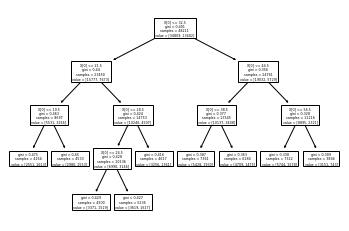

In [259]:
tree.plot_tree(dt,)

In [260]:
def cuts(df,feature,tgt):
    df[feature]=df[feature].astype(float)
    dt = DecisionTreeClassifier(max_depth=4, min_samples_leaf=0.08, max_features=1,random_state=0)
    X = df.loc[df[feature].notnull(), [feature]]
    y = df.loc[df[feature].notnull(), tgt]
    dt.fit(X, y)
    df.loc[df[feature].notnull(), f"aux_{feature}"] = dt.apply(X)
    aux = df[[f"aux_{feature}", feature]].groupby([f"aux_{feature}"]).agg(["min", "max"])
    aux.columns = aux.columns.droplevel(0)
    aux[f"Interval_{feature}"]= aux.apply(lambda x:[x['min'],x['max']],axis=1)
    inter_list=aux[f"Interval_{feature}"].tolist()
    inter_list[0][0]=-np.Inf
    inter_list[-1][-1]=np.Inf
    inter_list=pd.IntervalIndex.from_tuples(list(map(tuple,inter_list)),closed="both")
    name=feature.replace("c_","")
    df[f"v_arbol_{name}"]=pd.cut(df[feature].astype(float),bins=inter_list)
    df.drop(columns=[f"aux_{feature}"],inplace=True)
    return df

In [261]:
for col in tratamiento_2.filter(like="c_"):
    print(col)
    tratamiento_2=cuts(tratamiento_2,col,'tgt')

c_AGE
c_SHOP_RANK
c_MONTHS_IN_RESIDENCE
c_MONTHS_IN_THE_JOB
c_MATE_INCOME
c_QUANT_BANKING_ACCOUNTS
c_PERSONAL_NET_INCOME
c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION


Mi tabla no tiene missings, por lo que 
se procede así

In [262]:
tratamiento_2.shape[0] * 0.3

14463.3

In [263]:
X_train,X_test=train_test_split(tratamiento_2,random_state=0,stratify=tratamiento_2["tgt"], test_size=0.3)

In [264]:
#Completitud de las variables
def completitud(df):
    completitud_df=pd.DataFrame(df.isnull().sum())
    completitud_df.reset_index(inplace=True)
    completitud_df=completitud_df.rename(columns={"index":"columna",0:"missings"})
    completitud_df["completitud (%)"]=(1-completitud_df["missings"]/df.shape[0])*100
    completitud_df=completitud_df.sort_values(by="completitud (%)",ascending=True)
    completitud_df.reset_index(drop=True,inplace=True)
    return completitud_df

#Funcion para limpiar caracteres especiales
def clean_text(text, pattern="[^a-zA-Z0-9 ]",replace=" "):
    try:
        cleaned_text = unicodedata.normalize('NFD', text).encode('ascii', 'ignore')
        cleaned_text = re.sub(pattern, replace, cleaned_text.decode("utf-8"), flags=re.UNICODE)
        cleaned_text = u' '.join(cleaned_text.strip().lower().split())
    except:
        return text
    return cleaned_text

#Dataframe con la frecuencia de valores en una columna de un dataset
def conteo_df(df, col, x_label = " ", y_label="conteo"):
    if x_label.isspace():
        x_label = col
    return pd.DataFrame(df[col].value_counts()).reset_index().rename(columns= {"index": x_label, col: y_label})

def tree_cut(X_tr, X_te, feature, new_category, tgt, max_depth, min_samples_leaf):
    X_train = X_tr.copy()
    X_test = X_te.copy()

    # Árbol de decisión
    dt = DecisionTreeClassifier(max_depth=max_depth, min_samples_leaf=min_samples_leaf, max_features=1,random_state=0)
    X_feat = X_train.loc[X_train[feature].notnull(), [feature]]
    y_feat = X_train.loc[X_train[feature].notnull(), tgt]
    dt.fit(X_feat, y_feat)
    X_train.loc[X_train[feature].notnull(), new_category] = dt.apply(X_train.loc[X_train[feature].notnull(), [feature]])
    X_test.loc[X_test[feature].notnull(), new_category] = dt.apply(X_test.loc[X_test[feature].notnull(), [feature]])
    
    #intervales
    aux_train = X_train[[new_category, feature]].groupby([new_category]).agg(["min", "max"])

    aux_train.columns = aux_train.columns.droplevel(0)
    
    aux_train[f"Interval_{feature}"]= aux_train.apply(lambda x:[x['min'],x['max']],axis=1)
    inter_list_train=aux_train[f"Interval_{feature}"].tolist()
    inter_list_train[0][0]=-np.Inf
    inter_list_train[-1][-1]=np.Inf
    
    inter_list_train=pd.IntervalIndex.from_tuples(list(map(tuple,inter_list_train)),closed="both")
    
    X_train[new_category]=pd.cut(X_train[feature].astype(float),bins=inter_list_train)
    X_test[new_category]=pd.cut(X_test[feature].astype(float),bins=inter_list_train)

    #Revisamos si hay nulos
    if (X_train[new_category].isnull().sum() > 0):
        X_train[new_category] = X_train[new_category].cat.add_categories('missings')
        X_train[new_category].fillna('missings', inplace =True)

        X_test[new_category] = X_test[new_category].cat.add_categories('missings')
        X_test[new_category].fillna('missings', inplace =True)
            
    return X_train,X_test
    
    
def WOE(X_aux,feature,tgt):
    aux = X_aux[[feature, tgt]].groupby(feature).agg(["count", "sum"])
    aux["evento"] = aux[tgt, "sum"]
    aux["no_evento"] = aux[tgt, "count"] - aux[tgt, "sum"]
    aux["%evento"] = aux["evento"] / aux["evento"].sum()
    aux["%no_evento"] = aux["no_evento"] / aux["no_evento"].sum()
    aux["WOE"] = np.log(aux["%evento"] / aux["%no_evento"])
    IV=((aux["%evento"] - aux["%no_evento"])*aux["WOE"]).sum()
    aux.columns = aux.columns.droplevel(1)
    aux = aux[["WOE"]].reset_index().rename(columns={"WOE": f"W_{feature}"})
    return aux,IV


In [265]:
X_train.filter(like='c_')

,c_AGE,c_SHOP_RANK,c_MONTHS_IN_RESIDENCE,c_MONTHS_IN_THE_JOB,c_MATE_INCOME,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION
20392,19.0,0.0,12.0,0.0,0.0,0.0,200.0,0.0
24993,42.0,0.0,420.0,108.0,0.0,0.0,200.0,0.0
47625,95.0,0.0,408.0,36.0,0.0,0.0,900.0,0.0
43988,30.0,0.0,336.0,36.0,0.0,0.0,900.0,0.0
35710,22.0,0.0,264.0,0.0,0.0,0.0,2000.0,1.0
...,...,...,...,...,...,...,...,...
23572,29.0,0.0,84.0,24.0,0.0,0.0,900.0,0.0
28136,19.0,0.0,468.0,0.0,0.0,0.0,500.0,0.0
23251,40.0,0.0,12.0,12.0,0.0,0.0,800.0,2.0
17266,30.0,0.0,180.0,0.0,0.0,0.0,100.0,0.0


In [266]:
X_train, X_test = tree_cut(X_train, X_test, "c_AGE", "v_AGE", "tgt", 10, 0.18)
X_train["v_AGE"].value_counts(1).sort_index()

[-inf, 22.0]    0.218123
[23.0, 32.0]    0.267461
[33.0, 44.0]    0.281418
[45.0, inf]     0.232998
Name: v_AGE, dtype: float64

In [267]:
X_train, X_test = tree_cut(X_train, X_test, "c_SHOP_RANK", "v_SHOP_RANK", "tgt", 10, 0.12)
X_train["v_SHOP_RANK"].value_counts(1).sort_index()

[-inf, inf]    1.0
Name: v_SHOP_RANK, dtype: float64

In [268]:
X_train, X_test = tree_cut(X_train, X_test, "c_MONTHS_IN_RESIDENCE", "v_MONTHS_IN_RESIDENCE", "tgt", 10, 0.12)
X_train["v_MONTHS_IN_RESIDENCE"].value_counts(1).sort_index()

[-inf, 24.0]      0.217323
[36.0, 84.0]      0.214597
[96.0, 204.0]     0.235606
[216.0, 288.0]    0.176994
[300.0, inf]      0.155480
Name: v_MONTHS_IN_RESIDENCE, dtype: float64

In [269]:
X_train, X_test = tree_cut(X_train, X_test, "c_MONTHS_IN_THE_JOB", "v_MONTHS_IN_THE_JOB", "tgt", 10, 0.12)
X_train["v_MONTHS_IN_THE_JOB"].value_counts(1).sort_index()

[-inf, 0.0]     0.209678
[12.0, 24.0]    0.386257
[36.0, 84.0]    0.223872
[96.0, inf]     0.180194
Name: v_MONTHS_IN_THE_JOB, dtype: float64

In [270]:
X_train, X_test = tree_cut(X_train, X_test, "c_MATE_INCOME", "v_MATE_INCOME", "tgt", 10, 0.12)
X_train["v_MATE_INCOME"].value_counts(1).sort_index()

[-inf, inf]    1.0
Name: v_MATE_INCOME, dtype: float64

In [271]:

X_train, X_test = tree_cut(X_train, X_test, "c_QUANT_BANKING_ACCOUNTS", "v_QUANT_BANKING_ACCOUNTS", "tgt", 10, 0.12)
X_train["v_QUANT_BANKING_ACCOUNTS"].value_counts(1).sort_index()

[-inf, inf]    1.0
Name: v_QUANT_BANKING_ACCOUNTS, dtype: float64

In [272]:
X_train, X_test = tree_cut(X_train, X_test, "c_PERSONAL_NET_INCOME", "v_PERSONAL_NET_INCOME", "tgt", 10, 0.12)
X_train["v_PERSONAL_NET_INCOME"].value_counts(1).sort_index()

[-inf, 200.0]     0.289685
[300.0, 400.0]    0.284825
[500.0, 800.0]    0.236406
[900.0, inf]      0.189083
Name: v_PERSONAL_NET_INCOME, dtype: float64

In [273]:
woe_dict={}
iv_dict={}
for col in X_train.filter(like="v_").columns:
    aux,IV=WOE(X_train,col,"tgt")
    X_train=X_train.merge(aux, on=col, how="left")
    X_test=X_test.merge(aux, on=col, how="left")
    aux = aux.set_index(col)
    woe_dict[col] = aux.rename(columns={("W_" + col): "WOE"})
    iv_dict[col] = IV

In [274]:
X_test

,v_ID_SHOP,v_SEX,v_MARITAL_STATUS,c_AGE,v_FLAG_RESIDENCIAL_PHONE,g_AREA_CODE_RESIDENCIAL_PHONE,d_PAYMENT_DAY,c_SHOP_RANK,v_RESIDENCE_TYPE,c_MONTHS_IN_RESIDENCE,v_FLAG_MOTHERS_NAME,v_FLAG_FATHERS_NAME,v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,v_FLAG_RESIDENCE_STATE=WORKING_STATE,c_MONTHS_IN_THE_JOB,t_PROFESSION,c_MATE_INCOME,v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,c_QUANT_BANKING_ACCOUNTS,c_PERSONAL_NET_INCOME,c_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,tgt,v_arbol_AGE,v_arbol_SHOP_RANK,v_arbol_MONTHS_IN_RESIDENCE,v_arbol_MONTHS_IN_THE_JOB,v_arbol_MATE_INCOME,v_arbol_QUANT_BANKING_ACCOUNTS,v_arbol_PERSONAL_NET_INCOME,v_arbol_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,v_AGE,v_SHOP_RANK,v_MONTHS_IN_RESIDENCE,v_MONTHS_IN_THE_JOB,v_MATE_INCOME,v_QUANT_BANKING_ACCOUNTS,v_PERSONAL_NET_INCOME,W_v_ID_SHOP,W_v_SEX,W_v_MARITAL_STATUS,W_v_FLAG_RESIDENCIAL_PHONE,W_v_RESIDENCE_TYPE,W_v_FLAG_MOTHERS_NAME,W_v_FLAG_FATHERS_NAME,W_v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,W_v_FLAG_RESIDENCE_STATE=WORKING_STATE,W_v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,W_v_arbol_AGE,W_v_arbol_SHOP_RANK,W_v_arbol_MONTHS_IN_RESIDENCE,W_v_arbol_MONTHS_IN_THE_JOB,W_v_arbol_MATE_INCOME,W_v_arbol_QUANT_BANKING_ACCOUNTS,W_v_arbol_PERSONAL_NET_INCOME,W_v_arbol_QUANT_ADDITIONAL_CARDS_IN_THE_APPLICATION,W_v_AGE,W_v_SHOP_RANK,W_v_MONTHS_IN_RESIDENCE,W_v_MONTHS_IN_THE_JOB,W_v_MATE_INCOME,W_v_QUANT_BANKING_ACCOUNTS,W_v_PERSONAL_NET_INCOME
0,10,0,S,32.0,y,31,20,0.0,a,12.0,Y,Y,N,Y,0.0,Healthcare Practitioners and Technical,0.0,Y,0.0,800.0,0.0,1,"[29.0, 32.0]","[-inf, inf]","[-inf, 24.0]","[-inf, 0.0]","[-inf, inf]","[-inf, inf]","[600.0, 800.0]","[-inf, 0.0]","[23.0, 32.0]","[-inf, inf]","[-inf, 24.0]","[-inf, 0.0]","[-inf, inf]","[-inf, inf]","[500.0, 800.0]",0.042753,-0.065594,0.172196,-0.090796,0.098631,-0.000647,-0.00916,0.04239,-0.000628,-0.001663,0.088297,0.0,0.100573,0.097225,0.0,0.0,-0.080374,0.032462,0.124135,0.0,0.100573,0.097225,0.0,0.0,-0.067035
1,10,0,S,93.0,y,31,28,0.0,p,12.0,Y,Y,Y,Y,12.0,Educational Instruction and Library,0.0,Y,0.0,300.0,0.0,0,"[57.0, inf]","[-inf, inf]","[-inf, 24.0]","[12.0, 12.0]","[-inf, inf]","[-inf, inf]","[300.0, 300.0]","[-inf, 0.0]","[45.0, inf]","[-inf, inf]","[-inf, 24.0]","[12.0, 24.0]","[-inf, inf]","[-inf, inf]","[300.0, 400.0]",0.042753,-0.065594,0.172196,-0.090796,-0.035650,-0.000647,-0.00916,-0.05197,-0.000628,-0.001663,-0.471249,0.0,0.100573,0.215379,0.0,0.0,0.086356,0.032462,-0.389874,0.0,0.100573,0.176936,0.0,0.0,0.085010
2,17,0,S,18.0,y,31,18,0.0,p,36.0,Y,Y,N,Y,12.0,Educational Instruction and Library,0.0,Y,0.0,600.0,0.0,0,"[-inf, 19.0]","[-inf, inf]","[36.0, 60.0]","[12.0, 12.0]","[-inf, inf]","[-inf, inf]","[600.0, 800.0]","[-inf, 0.0]","[-inf, 22.0]","[-inf, inf]","[36.0, 84.0]","[12.0, 24.0]","[-inf, inf]","[-inf, inf]","[500.0, 800.0]",0.018930,-0.065594,0.172196,-0.090796,-0.035650,-0.000647,-0.00916,0.04239,-0.000628,-0.001663,0.545873,0.0,0.038481,0.215379,0.0,0.0,-0.080374,0.032462,0.390347,0.0,0.034729,0.176936,0.0,0.0,-0.067035
3,15,0,S,54.0,y,31,12,0.0,p,360.0,Y,Y,N,Y,12.0,Production,0.0,Y,0.0,2000.0,1.0,0,"[45.0, 56.0]","[-inf, inf]","[348.0, inf]","[12.0, 12.0]","[-inf, inf]","[-inf, inf]","[900.0, inf]","[1.0, inf]","[45.0, inf]","[-inf, inf]","[300.0, inf]","[12.0, 24.0]","[-inf, inf]","[-inf, inf]","[900.0, inf]",-0.075972,-0.065594,0.172196,-0.090796,-0.035650,-0.000647,-0.00916,0.04239,-0.000628,-0.001663,-0.348252,0.0,-0.153824,0.215379,0.0,0.0,-0.228872,-0.232099,-0.389874,0.0,-0.134730,0.176936,0.0,0.0,-0.228872
4,23,0,O,59.0,y,31,8,0.0,p,24.0,Y,Y,N,Y,0.0,Production,0.0,Y,0.0,1000.0,1.0,0,"[57.0, inf]","[-inf, inf]","[-inf, 24.0]","[-inf, 0.0]","[-inf, inf]","[-inf, inf]","[900.0, inf]","[1.0, inf]","[45.0, inf]","[-inf, inf]","[-inf, 24.0]","[-inf, 0.0]","[-inf, inf]","[-inf, inf]","[900.0, inf]",-0.077526,-0.065594,0.153340,-0.090796,-0.035650,-0.000647,-0.00916,0.04239,-0.000628,-0.001663,-0.471249,0.0,0.100573,0.097225,0.0,0.0,-0.228872,-0.232099,-0.389874,0.0,0.100573,0.097225,0.0,0.0,-0.228872
...,...,...,.

In [275]:
pd.concat(woe_dict)

WOE
v_ID_SHOP                1              -0.001626
                         2               0.081159
                         3               0.227952
                         4              -0.212248
                         5              -0.481729
...                                           ...
v_QUANT_BANKING_ACCOUNTS [-inf, inf]     0.000000
v_PERSONAL_NET_INCOME    [-inf, 200.0]   0.107789
                         [300.0, 400.0]  0.085010
                         [500.0, 800.0] -0.067035
                         [900.0, inf]   -0.228872

[109 rows x 1 columns]

In [276]:

iv_df = pd.DataFrame.from_dict(iv_dict, orient='index', columns=["IV"])
iv_df

,IV
v_ID_SHOP,inf
v_SEX,0.010004
v_MARITAL_STATUS,0.040883
v_FLAG_RESIDENCIAL_PHONE,0.033556
v_RESIDENCE_TYPE,0.002853
v_FLAG_MOTHERS_NAME,0.000112
v_FLAG_FATHERS_NAME,0.001881
v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,0.002203
v_FLAG_RESIDENCE_STATE=WORKING_STATE,0.000045
v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,0.000127


In [277]:
X_train = X_train.filter(like="W_")
X_test = X_test.filter(like="W_")

In [278]:

useless = iv_df[(iv_df["IV"] < 0.02) | (iv_df["IV"] > 0.5)]
useless

,IV
v_ID_SHOP,inf
v_SEX,0.010004
v_RESIDENCE_TYPE,0.002853
v_FLAG_MOTHERS_NAME,0.000112
v_FLAG_FATHERS_NAME,0.001881
v_FLAG_RESIDENCE_TOWN=WORKING_TOWN,0.002203
v_FLAG_RESIDENCE_STATE=WORKING_STATE,0.000045
v_FLAG_RESIDENCIAL_ADDRESS=POSTAL_ADDRESS,0.000127
v_arbol_SHOP_RANK,0.000000
v_arbol_MONTHS_IN_RESIDENCE,0.006364


In [279]:

X_train.drop(columns=["W_" + x for x in list(useless.index)],inplace=True)
X_test.drop(columns=["W_" + x for x in list(useless.index)],inplace=True)


TAMAÑO DEL EFECTO

In [280]:
c = list(X_train.filter(like='c_'))

In [281]:
X2 = stats.chi2_contingency(X_train['W_v_AGE'], correction=False)[0]

ValueError: All values in `observed` must be nonnegative.

# No se puede caluclar V-de cramer con esta técnica debido a que el estadístico CHI2 que se requiere, requiere de que no haya valores negativos

In [282]:
X_train

,W_v_MARITAL_STATUS,W_v_FLAG_RESIDENCIAL_PHONE,W_v_arbol_AGE,W_v_arbol_MONTHS_IN_THE_JOB,W_v_AGE,W_v_MONTHS_IN_THE_JOB
0,0.172196,0.370607,0.545873,0.097225,0.390347,0.097225
1,-0.241877,0.370607,-0.221837,-0.236129,-0.160038,-0.367462
2,0.172196,-0.090796,-0.471249,0.003849,-0.389874,-0.143933
3,-0.203773,-0.090796,0.088297,0.003849,0.124135,-0.143933
4,0.172196,-0.090796,0.180594,0.097225,0.390347,0.097225
...,...,...,...,...,...,...
33742,-0.241877,-0.090796,0.088297,0.003849,0.124135,0.176936
33743,0.172196,-0.090796,0.545873,0.097225,0.390347,0.097225
33744,-0.203773,-0.090796,-0.221837,0.215379,-0.160038,0.176936
33745,0.172196,-0.090796,0.088297,0.097225,0.124135,0.097225


In [283]:
X_train.to_csv('wow.csv')

In [285]:
X_test

,W_v_MARITAL_STATUS,W_v_FLAG_RESIDENCIAL_PHONE,W_v_arbol_AGE,W_v_arbol_MONTHS_IN_THE_JOB,W_v_AGE,W_v_MONTHS_IN_THE_JOB
0,0.172196,-0.090796,0.088297,0.097225,0.124135,0.097225
1,0.172196,-0.090796,-0.471249,0.215379,-0.389874,0.176936
2,0.172196,-0.090796,0.545873,0.215379,0.390347,0.176936
3,0.172196,-0.090796,-0.348252,0.215379,-0.389874,0.176936
4,0.153340,-0.090796,-0.471249,0.097225,-0.389874,0.097225
...,...,...,...,...,...,...
14459,-0.241877,-0.090796,0.088297,0.003849,0.124135,0.176936
14460,0.172196,-0.090796,0.180594,0.215379,0.124135,0.176936
14461,-0.241877,-0.090796,-0.471249,0.097225,-0.389874,0.097225
14462,0.172196,-0.090796,0.291264,0.003849,0.390347,0.176936


In [286]:
X_test.to_csv('woe_train.csv')